In [1]:
!pip install optuna
!pip install lightgbm
import pandas as pd
import numpy as np

import datetime
from datetime import datetime

from tqdm.auto import tqdm, trange
from copy import copy, deepcopy

import sys
import warnings
warnings.simplefilter("ignore")
from tqdm.auto import tqdm


import matplotlib.pyplot as plt
import plotly.express as px
import seaborn as sns
sns.set_style('whitegrid')

import statsmodels.api as sm
from sklearn.linear_model import LinearRegression
from statsmodels.api import OLS

from sklearn.metrics import mean_squared_error, mean_absolute_error, mean_absolute_percentage_error

import os

import matplotlib.dates as mdates
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import scipy.stats as ss
from sklearn.decomposition import PCA
from tqdm.notebook import tqdm

In [2]:
def split_data(df, split_date=None, start_date=None, end_date=None, with_val=False, val_size=0, test_size=1):
    if with_val:
        df_train = df.iloc[:-(val_size+test_size)]
        df_valid = df.iloc[-(val_size+test_size):-test_size]
        df_test = df.iloc[-test_size:]
        return df_train, df_valid, df_test
    else:
        train = df[df.date <= split_date]
        test = df[df.date > split_date]
        if start_date is not None:
            train = train[train.date >= start_date]
        if end_date is not None:
            test = test[test.date <= end_date]
        return train, test

In [3]:
df_risk = pd.read_csv('df_risk.csv')
#засплитим дату
df_train_all, df_test_all = split_data(df_risk, split_date='2023-12-02')


#функции

In [ ]:
def get_step_simulations(data, t, rounds=1000, random_state=42):
    """
    Симуляция процентного приращения риск-фактора на t шагов вперед
    """
    rnd = np.random.RandomState(random_state)
    if data.shape[1] > 1:
        corr_matrix = np.linalg.cholesky(np.corrcoef(data, rowvar=False))
    else:
        corr_matrix = np.array([[1]])
    rnd_vec = (
        corr_matrix
        @ np.cumsum(np.sqrt(1 / t) * rnd.normal(loc=0, scale=1, size=(data.shape[1], rounds, t)), axis=2)[:, :, -1]
    )
    # здесь вычисляется процентное приращение риск-фактора
    new_vals = np.exp((data.mean(axis=0) - data.std(axis=0) ** 2 / 2) / t + data.std(axis=0) * rnd_vec.T) - 1
    return new_vals

In [ ]:
def semaphore(p):
    if p > 0.05:
        return "green"
    elif p > 0.0001:
        return "yellow"
    else:
        return "red"


def norm_percenile(x, level):
    return np.mean(x) + ss.norm.ppf(level) * np.std(x)

#Стохастические модели динамики риск факторов

В классе StochModels реализованы построение симуляций стохастических моделей с оценкой их параметров по исторической выборке и выбор лучшей модели по RMSE

In [26]:
def Wiener_process(w0, dt, N_traj):
    d = 1
    N_t = len(dt) + 1
    W_s = np.zeros([N_traj, d, N_t])
    W_s[..., 0] = w0
    for kk in np.arange(1, N_t):
        noises = np.random.randn(N_traj, d)
        W_s[...,kk] = W_s[..., kk-1] + np.sqrt(dt[kk-1]) * noises
    return W_s[:,0,:]

def generate_dW_corr(data, dt, w0=0, N_traj=1):
    cholesky_matrix = np.linalg.cholesky(np.corrcoef(data, rowvar=False))
    dW = np.array([np.diff(Wiener_process(w0=w0, dt=dt,N_traj=N_traj)) for _ in range(data.shape[1])])

    dW_corr = dW.copy()

    for i in range(0, N_traj):
        dW_corr[:, i, :] = np.dot(cholesky_matrix, dW[:, i, :])

    return dW_corr  # (n_ft x N_traj x ts_len)

def parametrs_estimation_1(r, dt):
    # замена
    y = np.diff(r)
    X = np.concatenate([dt.reshape(-1, 1)], axis=1)
    # lin reg
    linreg = LinearRegression(fit_intercept=False)
    linreg.fit(X, y)
    y_pred = linreg.predict(X)
    # параметры
    a = linreg.coef_[0]
    b = np.std(y - y_pred)
    return {'a': a, 'b': b}

def process_1(param, r_0, dt, dWt):
    T = len(dt) + 1
    a, b = param['a'], param['b']

    r_sim = [r_0]
    for t in range(1, T):
        r_t1 = r_sim[t-1]
        r_t = r_t1 + a*dt[t-1] + b*dWt[t-1]
        r_sim.append(r_t)

    return np.asarray(r_sim)

def parametrs_estimation_2(r, dt):
    # замена
    r_t1 = r[:-1]
    y = np.diff(r) / r_t1
    X = np.concatenate([dt.reshape(-1, 1)], axis=1)
    # lin reg
    linreg = LinearRegression(fit_intercept=False)
    linreg.fit(X, y)
    y_pred = linreg.predict(X)
    # параметры
    a = linreg.coef_[0]
    b = np.std(y - y_pred)
    return {'a': a, 'b': b}

def process_2(param, r_0, dt, dWt):
    T = len(dt) + 1
    a, b = param['a'], param['b']

    r_sim = [r_0]
    for t in range(1, T):
        r_t1 = r_sim[t-1]
        r_t = r_t1 + a*r_t1*dt[t-1] + b*r_t1*dWt[t-1]
        r_sim.append(r_t)

    return np.asarray(r_sim)

def parametrs_estimation_CIR(r, dt):
    # замена
    sqrt_r_t1 = np.sqrt(r[:-1])
    y = np.diff(r) / sqrt_r_t1
    x_1 = dt / sqrt_r_t1
    x_2 = dt * sqrt_r_t1
    X = np.concatenate([x_1.reshape(-1, 1), x_2.reshape(-1, 1)], axis=1)
    # lin reg
    linreg = LinearRegression(fit_intercept=False)
    linreg.fit(X, y)
    y_pred = linreg.predict(X)
    # параметры: #p1 = ab, p2 = -a
    ab = linreg.coef_[0]
    a = -linreg.coef_[1]
    b = ab / a
    c = np.std(y - y_pred)
    if 2*a*b < c**2:
        #print('Ошибка в параметрах')
        print('Внимание: 2ab < c^2')
    return {'a': a, 'b': b, 'c': c}

def process_CIR(param, r_0, dt, dWt):
    T = len(dt) + 1
    a, b, c = param['a'], param['b'], param['c']

    r_sim = [r_0]
    for t in range(1, T):
        r_t1 = r_sim[t-1]
        r_t = r_t1 + a*(b - r_t1)*dt[t-1] + c*np.sqrt(np.abs(r_t1))*dWt[t-1]
        r_sim.append(r_t)

    return np.asarray(r_sim)

def parametrs_estimation_FX(r, dt):
    # замена
    y = np.diff(r)
    x_1 = dt
    x_2 = dt * r[:-1]
    X = np.concatenate([x_1.reshape(-1, 1), x_2.reshape(-1, 1)], axis=1)
    # lin reg
    linreg = LinearRegression(fit_intercept=False)
    linreg.fit(X, y)
    y_pred = linreg.predict(X)
    # параметры
    a = -linreg.coef_[1]
    b = linreg.coef_[0] / a
    c = np.std(y - y_pred)
    return {'k': a, 'theta': b, 'sigma': c}

def process_FX(param, r_0, dt, dWt):
    T = len(dt) + 1
    k, th, sigma = param['k'], param['theta'], param['sigma']

    y_sim = [r_0]
    for t in range(1, T):
        y_t1 = y_sim[t-1]
        y_t = y_t1 + k*(th - y_t1)*dt[t-1] + sigma*dWt[t-1]
        y_sim.append(y_t)

    return np.exp(y_sim)

def calculate_metric(y_true, y_sim_N, mode='rmse'):
    res = []
    if mode == 'rmse':
        for y_sim in y_sim_N:
            #print(y_sim)
            res.append(mean_squared_error(y_true, y_sim, squared=False))
        return np.mean(res)
    elif mode == 'mae':
        for y_sim in y_sim_N:
            res.append(mean_absolute_error(y_true, y_sim))
        return np.mean(res)
    elif mode == 'mape':
        for y_sim in y_sim_N:
            res.append(mean_absolute_percentage_error(y_true, y_sim))
        return np.mean(res)
    else:
        return None

In [24]:
class Stoch_Models:
    def __init__(self, factor_name,
                 value_train, value_test,
                 t_train, t_test,
                 N_traj=10, dW_N=None, models=None):
        self.name = factor_name
        self.val_train = value_train
        self.val_test = value_test
        self.val_t0 = value_train[0]
        self.val_last = value_train[-1]
        self.t_train = t_train
        self.t_test = t_test
        self.t_array = t_train + t_test
        self.N_traj = N_traj

        # модели
        if models is None:
            self.models = ['m1', 'm2', 'm3']
        else:
            self.models = models

        self.models_info = {
            'm1': '$a dt + b dW_t$',
            'm2': '$a X_t dt + b X_t dW_t$',
            'm3': 'CIR',
            'm4': 'FX'
        }

        # приращения винеровского процесса
        self.dW_N = self.Wiener_simulation() if dW_N is None else dW_N

        # параметры
        self.parametrs_func = {
            'm1': parametrs_estimation_1,
            'm2': parametrs_estimation_2,
            'm3': parametrs_estimation_CIR,
            'm4': parametrs_estimation_FX
        }
        self.paramters = {}

        # симуляции
        self.simulations_func = {
            'm1': process_1,
            'm2': process_2,
            'm3': process_CIR,
            'm4': process_FX
        }
        self.simulations = {}

        # метрика
        self.metric = 'rmse'
        self.res_metric = {}

        #для визуализации
        self.colors = {
            'm1': 'goldenrod',
            'm2': 'seagreen',
            'm3': 'steelblue',
            'm4': 'indianred',
            'factor': 'black'
        }

    def Wiener_simulation(self):
        w0=0
        dt_ = np.diff(self.t_array)
        wiener_traj = Wiener_process(w0, dt_, self.N_traj)
        dW_N = np.diff(wiener_traj, axis=1)
        return dW_N

    def find_parametrs(self):
        # для каждой стох. модели по train подбираются коээфициенты
        for m in self.models:
            self.paramters[m] = self.parametrs_func[m](self.val_train, np.diff(self.t_train))

    def make_simulations(self):
        self.find_parametrs()
        ct = len(self.t_train)-1
        for m in self.models:
            r_traj = []
            for dWt in self.dW_N[:, :ct]:
                r_tr = self.simulations_func[m](param=self.paramters[m], r_0=self.val_t0, dt=np.diff(self.t_train), dWt=dWt)
                r_traj.append(np.array(r_tr))
            self.simulations[m] = np.array(r_traj)

    def plot_simulations(self, fig_size=(18, 8)):
        fig, axs = plt.subplots(1, 1, figsize=fig_size)
        for m in self.models:
            axs.plot(self.t_train, self.simulations[m].T, color=self.colors[m], linewidth=0.5)
            axs.plot(self.t_train, np.mean(self.simulations[m], axis=0), color=self.colors[m], linewidth=2, label=self.models_info[m])
        axs.plot(self.t_train, self.val_train, color=self.colors['factor'], linewidth=1.5, label='factor')
        axs.legend()
        axs.set_title(self.name)
        plt.show()

    def print_metric_result(self):
        print(self.metric, '\n')
        for m in self.models:
            print(f'{m}: {round(self.res_metric[m], 4)}')

    def find_best_model(self):
        min_m = min(self.res_metric.values())
        best_model = None
        for m in self.res_metric.keys():
            if self.res_metric[m] == min_m:
                best_model = m
        return best_model

    def plot_simulations_best(self, fig_size=(18, 8)):
        m = self.find_best_model()
        fig, axs = plt.subplots(1, 1, figsize=fig_size)
        axs.plot(self.t_train, self.simulations[m].T, color=self.colors[m], linewidth=0.5)
        axs.plot(self.t_train, np.mean(self.simulations[m], axis=0), color=self.colors[m], linewidth=2, label=self.models_info[m])
        axs.plot(self.t_train, self.val_train, color=self.colors['factor'], linewidth=1.5, label='factor')
        axs.legend()
        axs.set_title(f'{self.name}, лучшая модель ({self.metric} = {round(self.res_metric[m], 2)})')
        plt.show()

    def choose_model(self, metric=None, print_metric=1, plot_all=1, plot_best=1, fig_size=(18, 8)):
        if metric is not None:
            self.metric = metric

        self.make_simulations()
        for m in self.models:
            #print(m)
            #print(self.simulations[m])
            self.res_metric[m] = calculate_metric(self.val_train, self.simulations[m], mode=self.metric)

        if print_metric == 1:
            self.print_metric_result()
        if plot_all == 1:
            self.plot_simulations(fig_size)
        if plot_best == 1:
            self.plot_simulations_best(fig_size)

    # моделирование значений на будущее
    def plot_simulations_future(self, r_traj, m, t, fig_size=(20, 5)):
        fig, axs = plt.subplots(1, 1, figsize=fig_size)
        axs.plot(self.t_test[:t], self.val_test[:t], color=self.colors['factor'], linewidth=1.5, label='factor')
        axs.plot(self.t_test[:t], r_traj.T, color=self.colors[m], linewidth=0.5)
        axs.legend()
        metr = calculate_metric(self.val_test[:t], r_traj, mode=self.metric)
        axs.set_title(f'{self.name}: моделирование будущих значений ({self.metric} = {round(metr, 2)})')
        plt.show()

    def future_simulation(self, n_steps=None, best_model=None, plot=0):
        if best_model is None:
            best_model = self.find_best_model()
        if n_steps is None:
            n_steps = len(self.t_test)
        ct = len(self.t_train)-1
        dt_ = np.diff(self.t_array[ct:ct+n_steps+1])
        dWts = self.dW_N[:, ct:ct+n_steps]
        r_traj = []
        for dWt in dWts:
            r_tr = self.simulations_func[best_model](param=self.paramters[best_model], r_0=self.val_last, dt=dt_, dWt=dWt)
            # Преобразуем в процентное приращение
            r_tr_percentage = (r_tr[1:] / r_tr[:-1] - 1) * 100

            r_traj.append(np.array(r_tr_percentage))
        if plot == 1:
            self.plot_simulations_future(np.array(r_traj), best_model, n_steps)

            #r_traj.append(np.array(r_tr[1:]))
        #if plot == 1:
            #self.plot_simulations_future(np.array(r_traj), best_model, n_steps)
        return np.array(r_traj)

In [6]:
#f_col = 'v_10'
#sm = Stoch_Models(factor_name=f_col,
#                 value_train = df_train_all[f_col].values, value_test = df_test_all[f_col].values,
#                 t_train = list(df_train_all.index), t_test = list(df_test_all.index),
#                 models=['m1', 'm2', 'm3', 'm4'], N_traj=100)
#sm.choose_model(print_metric=0, plot_all=0, metric='rmse')

In [7]:
#f_col = 'BRENT'
#sm = Stoch_Models(factor_name=f_col,
#                 value_train = df_train_all[f_col].values, value_test = df_test_all[f_col].values,
#                 t_train = list(df_train_all.index), t_test = list(df_test_all.index),
#                 models=['m1', 'm2'], N_traj=100)
#sm.choose_model(print_metric=0, plot_all=0, metric='rmse')

In [8]:
#f_col = 'USD'
#sm = Stoch_Models(factor_name=f_col,
#                 value_train = df_train_all[f_col].values, value_test = df_test_all[f_col].values,
#                 t_train = list(df_train_all.index), t_test = list(df_test_all.index),
#                 models=['m1', 'm2', 'm3', 'm4'], N_traj=100)
#sm.choose_model(print_metric=0, plot_all=0, metric='rmse')

In [31]:
stonks = df_risk[['GAZP', 'GMKN', 'LKOH', 'MGNT', 'MTSS', 'NVTK', 'ROSN',
                  'SBER', 'TRNFP', 'YNDX']]

features_tools = df_risk[['GAZP', 'GMKN', 'LKOH', 'MGNT', 'MTSS', 'NVTK', 'ROSN',
                       'SBER', 'TRNFP', 'YNDX', 'SU26207RMFS9',
                       'SU26207RMFS9', 'SU26212RMFS9', 'SU26224RMFS4', 'SU26225RMFS1',
                       'SU26228RMFS5', 'USD', 'EUR']]

features_risk = df_risk[['v_0_25', 'v_0_5', 'v_0_75', 'v_1', 'v_2', 'v_3',
                       'v_5', 'v_7', 'v_10', 'v_15', 'v_20', 'v_30',
                       "BRENT", 'MOEXBC', 'RTSI', 'USD', 'EUR']]

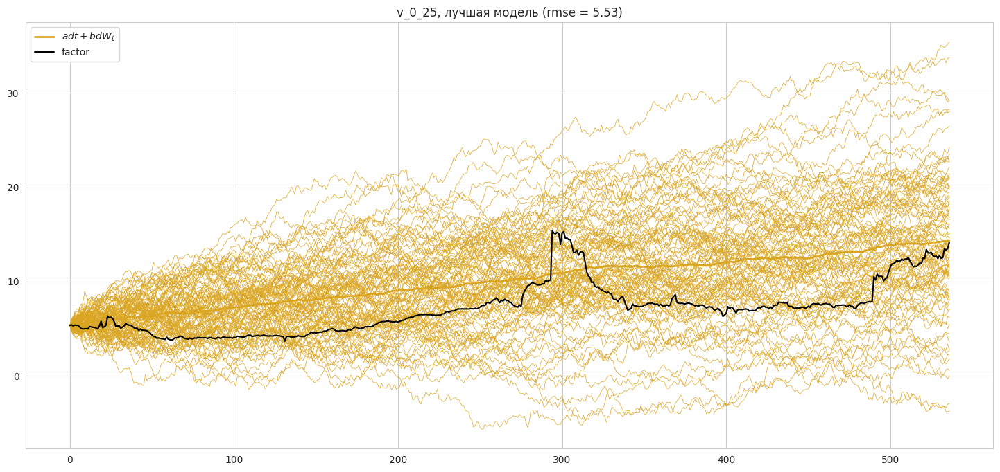

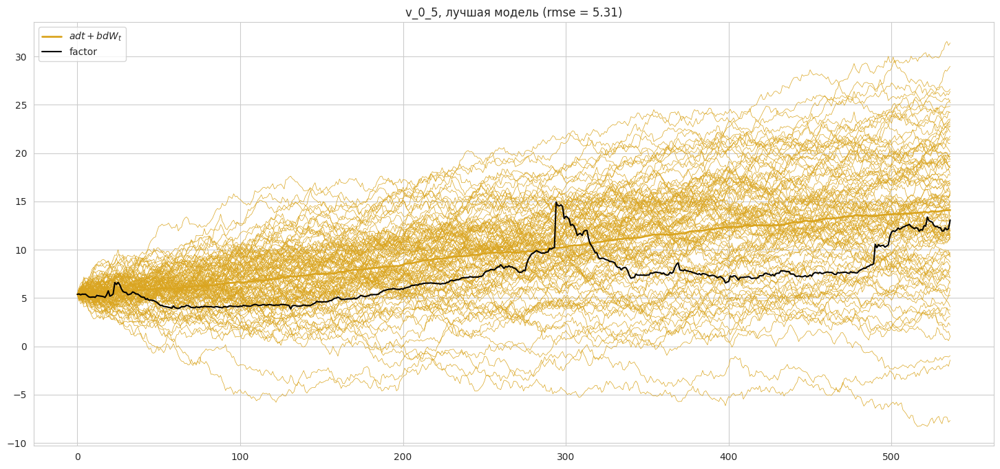

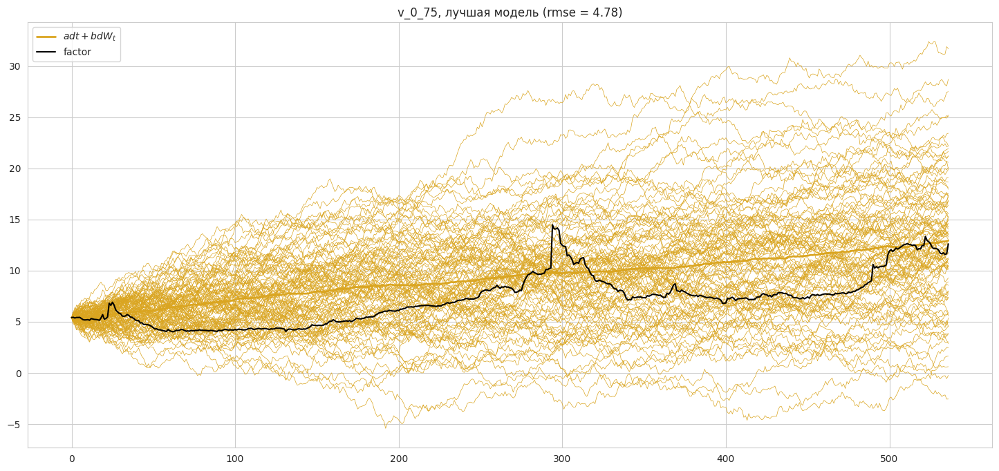

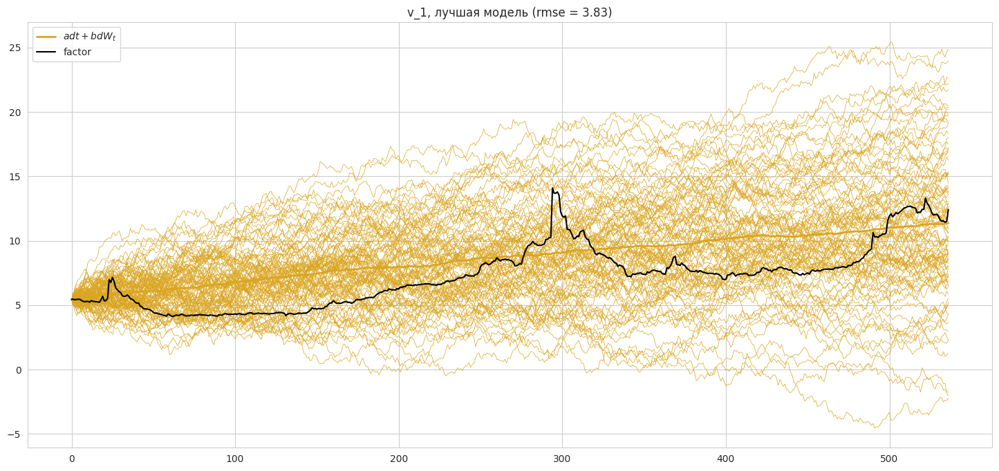

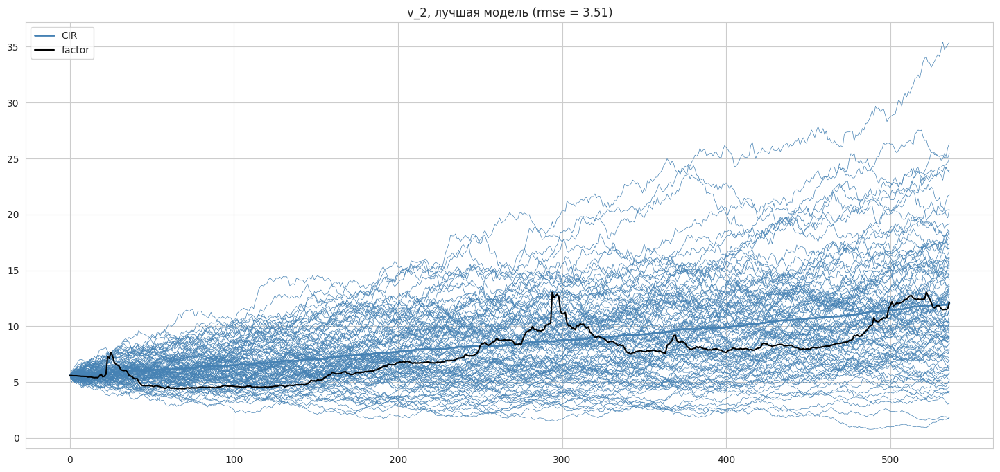

...

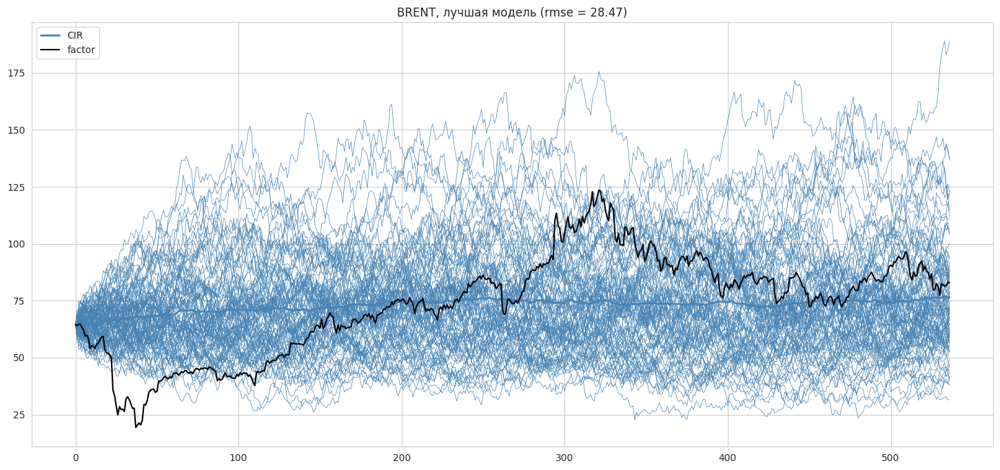

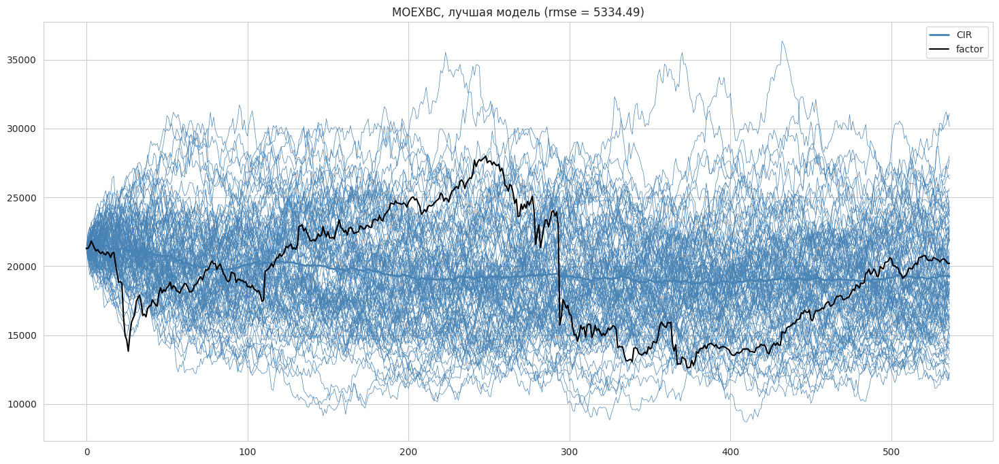

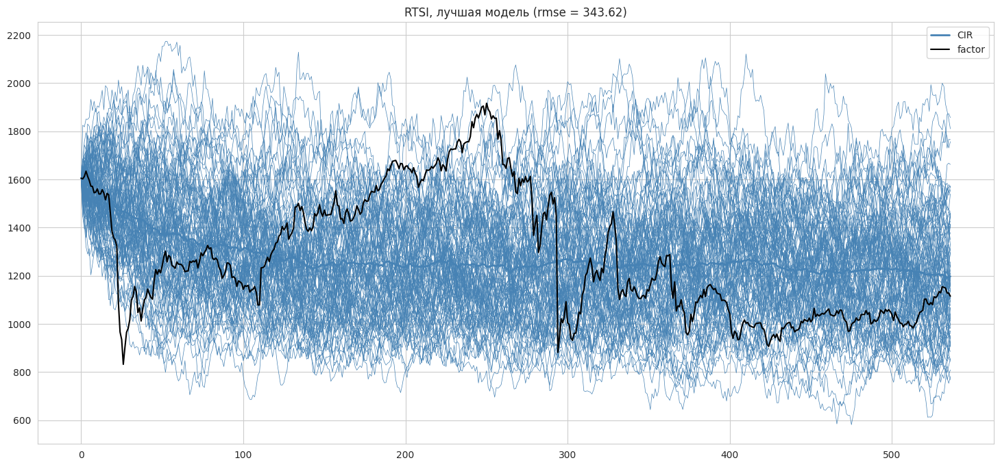

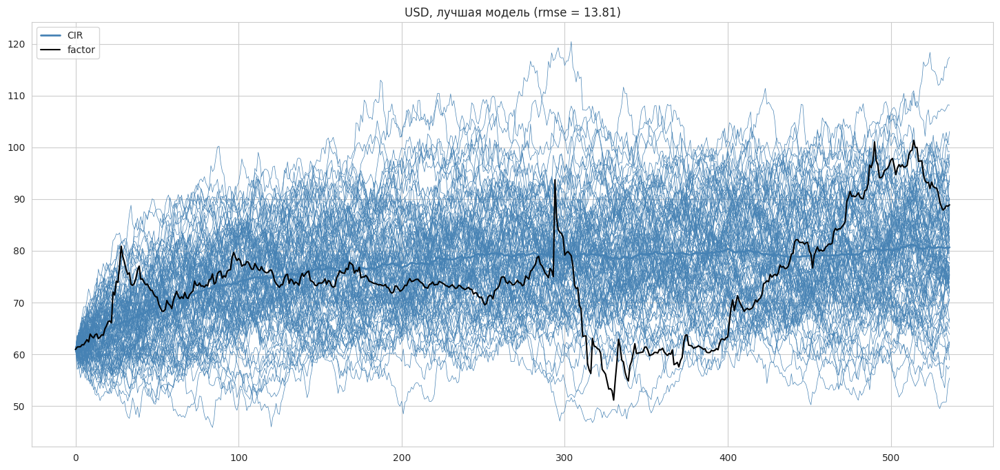

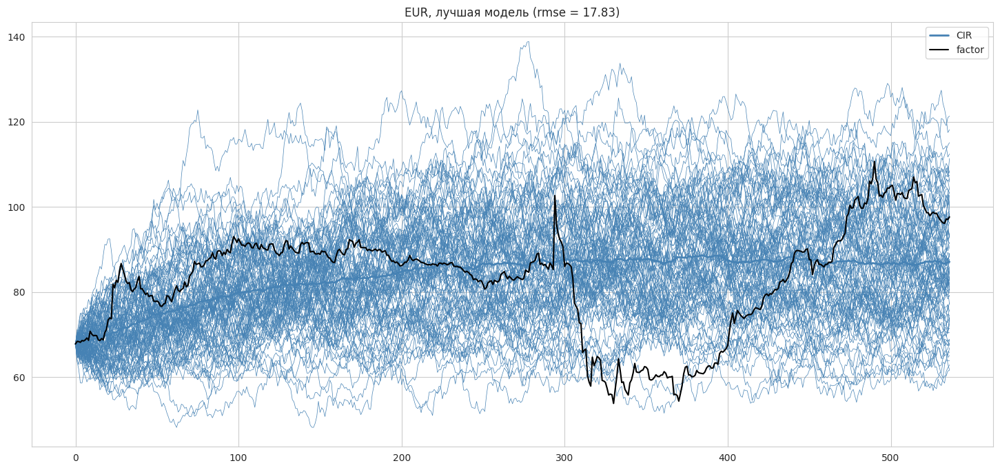

In [27]:
for factor in features_risk.columns:
    sm = Stoch_Models(factor_name=factor,
                 value_train = df_train_all[factor].values, value_test = df_test_all[factor].values,
                 t_train = list(df_train_all.index), t_test = list(df_test_all.index),
                 models=['m1', 'm2', 'm3'], N_traj=100)
    sm.choose_model(print_metric=0, plot_all=0, metric='rmse')

In [32]:
stonks_riskf = df_risk[['MOEXBC', "BRENT", 'RTSI']]
ofz = df_risk[['SU26207RMFS9',
                       'SU26207RMFS9', 'SU26212RMFS9', 'SU26224RMFS4', 'SU26225RMFS1',
                       'SU26228RMFS5']]
ofz_riskf = df_risk[['v_0_25', 'v_0_5', 'v_0_75', 'v_1', 'v_2', 'v_3',
                       'v_5', 'v_7', 'v_10', 'v_15', 'v_20', 'v_30']]
curr =  df_risk[[ 'USD', 'EUR']]
curr_riskf =  df_risk[[ "BRENT", 'USD', 'EUR']]

In [33]:
ozf_with_risks = df_risk[['SU26207RMFS9',
                       'SU26207RMFS9', 'SU26212RMFS9', 'SU26224RMFS4', 'SU26225RMFS1',
                       'SU26228RMFS5','v_0_25', 'v_0_5', 'v_0_75', 'v_1', 'v_2', 'v_3',
                       'v_5', 'v_7', 'v_10', 'v_15', 'v_20', 'v_30']]
stonks_with_risks = df_risk[['GAZP', 'GMKN', 'LKOH', 'MGNT', 'MTSS', 'NVTK', 'ROSN',
                  'SBER', 'TRNFP', 'YNDX',  'MOEXBC']]
curr_with_risks = df_risk[[ 'USD', 'EUR', "BRENT" ]]

##Оценка справедливой стоимости инструментов

С помощью классса `Model` реализован интерфейс обучения и применения PCA и линейной регрессии для перевода приращений PCA риск-факторов в приращения инструмента

Далее в классе `AutoModel` представлен подбор оптимального кол-ва PCA для каждого инструмента с помощью библиотеки `optuna`

In [102]:

class Model:
    def __init__(self, n_components=None, pca_args=None, lr_args=None):
        self.pca_args = pca_args or {"random_state": 42}
        self.lr_args = lr_args or {}
        self.n_components = n_components
        self.pca = n_components and PCA(n_components, **self.pca_args)
        self.lr = LinearRegression(**self.lr_args)
        self.cols = None
        self.selected_factors = None

    def get_values(self, x):
        if self.cols and isinstance(x, pd.DataFrame):
            x = x[self.cols]
        if isinstance(x, (pd.DataFrame, pd.Series)):
            return x.values
        return x

    def fit(self, data, target):
        if isinstance(data, pd.DataFrame):
            self.cols = list(data.columns)
        data = self.get_values(data)
        target = self.get_values(target)
        if self.pca:
            data = self.pca.fit_transform(data)
            self.selected_factors = self.pca.get_feature_names_out()[:self.n_components]
        self.lr.fit(data, target)
        return self

    def predict_pca(self, data):
        data = self.get_values(data)
        if self.pca:
            return self.pca.transform(data)
        return data

    def predict_lr(self, data):
        return self.lr.predict(data)

    def predict(self, data):
        data = self.predict_pca(data)
        return self.predict_lr(data)

    def __repr__(self):
        return "{}({}, {})".format(self.__class__.__name__, self.pca, self.lr)


class AutoModel:
    def __init__(self, cv_splits=5, n_trials=10, max_components=10, metric=None):
        self.splitter = TimeSeriesSplit(cv_splits)
        self.study = optuna.study.create_study(sampler=optuna.samplers.TPESampler(seed=42), direction="maximize")
        self.metric = metric or r2_score
        self.n_trials = n_trials
        self.max_components = max_components

    def fit(self, data, target):
        data_ = data
        target_ = target
        if isinstance(data, (pd.DataFrame, pd.Series)):
            data = data.values
        if isinstance(target, (pd.DataFrame, pd.Series)):
            target = target.values

        def objective(trial):
            components = trial.suggest_int("n_components", 1, min([self.max_components, *data.shape]))
            for t in trial.study.trials:
                if t.state != optuna.trial.TrialState.COMPLETE:
                    continue
                if t.params == trial.params:
                    raise optuna.exceptions.TrialPruned("Duplicate parameter set")

            scores = []
            for train_idx, test_idx in self.splitter.split(data):
                model = Model(components)
                model.fit(data[train_idx], target[train_idx])
                proba = model.predict(data[test_idx])
                score = self.metric(target[test_idx], proba)
                scores.append(score)
            return np.mean(scores)

        self.study.optimize(objective, self.n_trials)
        return Model(**self.study.best_params).fit(data_, target_)

Акции

In [103]:
results = []
instrument_models = {}

for f in stonks.columns:
    m = AutoModel().fit(df_train_all[stonks_riskf.columns], df_train_all[f])
    score = m.predict(df_train_all)
    score_test = m.predict(df_test_all)
    results.append(
        {
            "tool": f,
            "n_components": m.n_components,
            "r2_train": r2_score(df_train_all[f], score),
            "r2_test": r2_score(df_test_all[f], score_test),
        }
    )
    instrument_models[f] = m
results = pd.DataFrame(results)
results

,tool,n_components,r2_train,r2_test
0,GAZP,2,0.719066,-42.167932
1,GMKN,1,0.625686,-86.456408
2,LKOH,1,0.744113,-57.046851
3,MGNT,1,0.299099,-21.086153
4,MTSS,1,0.495539,-432.645618
5,NVTK,3,0.895822,-0.440389
6,ROSN,1,0.782930,-42.256786
7,SBER,2,0.928466,-1.728403
8,TRNFP,2,0.711778,-0.867023
9,YNDX,1,0.751144,-98.796843


ОФЗ

In [35]:
results = []
instrument_models = {}

for f in ofz.columns:
    m = AutoModel().fit(df_train_all[ofz_riskf.columns], df_train_all[f])
    score = m.predict(df_train_all)
    score_test = m.predict(df_test_all)
    results.append(
        {
            "tool": f,
            "n_components": m.n_components,
            "r2_train": r2_score(df_train_all[f], score),
            "r2_test": r2_score(df_test_all[f], score_test),
        }
    )
    instrument_models[f] = m
results = pd.DataFrame(results)
results

,tool,n_components,r2_train,r2_test
0,SU26207RMFS9,1,0.949276,-121.084136
1,SU26207RMFS9,1,0.949276,-121.084136
2,SU26212RMFS9,1,0.948684,-180.021416
3,SU26224RMFS4,6,0.983005,-15.133465
4,SU26225RMFS1,4,0.989245,-19.996884
5,SU26228RMFS5,6,0.985295,-22.302683


Валюта

In [36]:
results = []
instrument_models = {}

for f in curr.columns:
    m = AutoModel().fit(df_train_all[curr_riskf.columns], df_train_all[f])
    score = m.predict(df_train_all)
    score_test = m.predict(df_test_all)
    results.append(
        {
            "tool": f,
            "n_components": m.n_components,
            "r2_train": r2_score(df_train_all[f], score),
            "r2_test": r2_score(df_test_all[f], score_test),
        }
    )
    instrument_models[f] = m
results = pd.DataFrame(results)
results

,tool,n_components,r2_train,r2_test
0,USD,3,1.0,1.0
1,EUR,3,1.0,1.0


Возьмем логарифм цен

In [37]:
df_train_all_ind = df_train_all.copy()
df_test_all_ind = df_test_all.copy()

df_train_all_ind.set_index('date', inplace=True)
df_test_all_ind.set_index('date', inplace=True)

In [38]:
df_train_log = df_train_all_ind.applymap(np.log)
df_test_log = df_test_all_ind.applymap(np.log)


In [39]:
results = []
instrument_models = {}

for f in stonks.columns:
    m = AutoModel().fit(df_train_log[stonks_riskf.columns], df_train_log[f])
    score = m.predict(df_train_log)
    score_test = m.predict(df_test_log)
    results.append(
        {
            "tool": f,
            "n_components": m.n_components,
            "r2_train": r2_score(df_train_log[f], score),
            "r2_test": r2_score(df_test_log[f], score_test),
        }
    )
    instrument_models[f] = m
results = pd.DataFrame(results)
results

,tool,n_components,r2_train,r2_test
0,GAZP,3,0.781391,-92.298450
1,GMKN,2,0.746100,-15.046388
2,LKOH,3,0.842613,-28.864790
3,MGNT,1,0.127863,-27.222495
4,MTSS,2,0.745771,-125.043100
5,NVTK,3,0.889292,-0.490654
6,ROSN,3,0.949486,-14.198359
7,SBER,3,0.916868,-1.124646
8,TRNFP,3,0.783817,-3.191681
9,YNDX,3,0.856067,-20.148509


In [40]:
results = []
instrument_models = {}

for f in ofz.columns:
    m = AutoModel().fit(df_train_log[ofz_riskf.columns], df_train_log[f])
    score = m.predict(df_train_log)
    score_test = m.predict(df_test_log)
    results.append(
        {
            "tool": f,
            "n_components": m.n_components,
            "r2_train": r2_score(df_train_log[f], score),
            "r2_test": r2_score(df_test_log[f], score_test),
        }
    )
    instrument_models[f] = m
results = pd.DataFrame(results)
results

,tool,n_components,r2_train,r2_test
0,SU26207RMFS9,1,0.980028,-23.398190
1,SU26207RMFS9,1,0.980028,-23.398190
2,SU26212RMFS9,1,0.973864,-35.632025
3,SU26224RMFS4,6,0.988773,-0.815291
4,SU26225RMFS1,2,0.993192,0.727724
5,SU26228RMFS5,6,0.992109,-0.941911


In [41]:
results = []
instrument_models = {}

for f in curr.columns:
    m = AutoModel().fit(df_train_log[curr_riskf.columns], df_train_log[f])
    score = m.predict(df_train_log)
    score_test = m.predict(df_test_log)
    results.append(
        {
            "tool": f,
            "n_components": m.n_components,
            "r2_train": r2_score(df_train_log[f], score),
            "r2_test": r2_score(df_test_log[f], score_test),
        }
    )
    instrument_models[f] = m
results = pd.DataFrame(results)
results

,tool,n_components,r2_train,r2_test
0,USD,3,1.0,1.0
1,EUR,3,1.0,1.0


In [42]:
results = []
instrument_models = {}

for f in curr.columns:
    m = AutoModel().fit(df_train_log[curr_riskf.columns], df_train_log[f])
    score = m.predict(df_train_log)
    score_test = m.predict(df_test_log)
    results.append(
        {
            "tool": f,
            "n_components": m.n_components,
            "r2_train": r2_score(df_train_log[f], score),
            "r2_test": r2_score(df_test_log[f], score_test),
        }
    )
    instrument_models[f] = m
results = pd.DataFrame(results)
results

,tool,n_components,r2_train,r2_test
0,USD,3,1.0,1.0
1,EUR,3,1.0,1.0


Попробуем проц приращения на логарифм

In [43]:
df_train_log_pca = df_train_log.pct_change().dropna(axis=0)
df_test_log_pca = df_test_log.pct_change().dropna(axis=0)
df_train_all_indexed = df_risk.copy()
df_train_all_indexed.set_index('date', inplace=True)
df_risk_log_pca = df_train_all_indexed.applymap(np.log).pct_change().dropna(axis=0)

In [44]:
results = []
instrument_models = {}

for f in stonks.columns:
    m = AutoModel().fit(df_train_log_pca[stonks_riskf.columns], df_train_log_pca[f])
    score = m.predict(df_train_log_pca)
    score_test = m.predict(df_test_log_pca)
    results.append(
        {
            "tool": f,
            "n_components": m.n_components,
            "r2_train": r2_score(df_train_log_pca[f], score),
            "r2_test": r2_score(df_test_log_pca[f], score_test),
        }
    )
    instrument_models[f] = m
results = pd.DataFrame(results)
results

,tool,n_components,r2_train,r2_test
0,GAZP,3,0.599163,0.330994
1,GMKN,3,0.328878,0.153014
2,LKOH,3,0.688443,-1.055618
3,MGNT,3,0.502374,0.294177
4,MTSS,3,0.497832,0.523112
5,NVTK,3,0.385475,0.376141
6,ROSN,3,0.736179,0.572866
7,SBER,3,0.781958,0.649226
8,TRNFP,2,0.375592,0.236484
9,YNDX,3,0.542807,0.352031


In [45]:
results = []

for f in ofz.columns:
    m = AutoModel().fit(df_train_log_pca[ofz_riskf.columns], df_train_log_pca[f])
    score = m.predict(df_train_log_pca)
    score_test = m.predict(df_test_log_pca)
    results.append(
        {
            "tool": f,
            "n_components": m.n_components,
            "r2_train": r2_score(df_train_log_pca[f], score),
            "r2_test": r2_score(df_test_log_pca[f], score_test),
        }
    )
    instrument_models[f] = m
results = pd.DataFrame(results)
results

,tool,n_components,r2_train,r2_test
0,SU26207RMFS9,2,0.463797,0.706171
1,SU26207RMFS9,2,0.463797,0.706171
2,SU26212RMFS9,2,0.462967,0.572217
3,SU26224RMFS4,2,0.474758,0.637943
4,SU26225RMFS1,2,0.438299,0.573049
5,SU26228RMFS5,2,0.482470,0.654680


In [47]:
results = []
for f in curr.columns:
    m = AutoModel().fit(df_train_log_pca[curr_riskf.columns], df_train_log_pca[f])
    score = m.predict(df_train_log_pca)
    score_test = m.predict(df_test_log_pca)
    results.append(
        {
            "tool": f,
            "n_components": m.n_components,
            "r2_train": r2_score(df_train_log_pca[f], score),
            "r2_test": r2_score(df_test_log_pca[f], score_test),
        }
    )
    instrument_models[f] = m
results = pd.DataFrame(results)
results

,tool,n_components,r2_train,r2_test
0,USD,3,1.0,1.0
1,EUR,3,1.0,1.0


In [104]:
results = []
instrument_models_all = {}
for f in features_tools.columns:
    m = AutoModel().fit(df_train_log_pca[features_risk.columns], df_train_log_pca[f])
    score = m.predict(df_train_log_pca)
    score_test = m.predict(df_test_log_pca)
    results.append(
        {
            "tool": f,
            "n_components": m.n_components,
            "r2_train": r2_score(df_train_log_pca[f], score),
            "r2_test": r2_score(df_test_log_pca[f], score_test),
        }
    )
    instrument_models_all[f] = m
results = pd.DataFrame(results)
results

,tool,n_components,r2_train,r2_test
0,GAZP,10,0.600859,0.359191
1,GMKN,10,0.405561,0.106986
2,LKOH,10,0.693040,-0.515922
3,MGNT,9,0.494830,0.097686
4,MTSS,10,0.547732,0.250095
5,NVTK,10,0.433237,0.408286
6,ROSN,10,0.755327,0.555627
7,SBER,10,0.786842,0.499501
8,TRNFP,7,0.391369,0.147247
9,YNDX,10,0.542325,0.235091



В классе `Portfolio` реализован портфель из инструментов `Intrument`, позволяющий ребалансировать долю инструментов и расчитывать стоимость порфеля:

$$ \text{portfolio_cost} = \sum_i \text{count}_i \text{price}_i $$

В классе `PortfolioSimulation` реализована основная логика расчетов:
1. Для каждого инструмента (облигации и валюта) подбираем оптимальное кол-во PCA риск-факторов по обучающей выборке и обучаем модель линейной ререссии переводить изменения PCA в изменение иструмента
2. Симулируем коррелированные приращения риск-факторов
3. От симуляций риск-факторов переходим к PCA и с помощью модели линейной регрессии получаем соответствующие изменения инструмента (для облигаций и валюты)
4. По изменениям инструменов определяем изменение стоимости порфеля
5. Оцениваем меры риска по порфелю на каждый день (Value-at-Risk на уровне 99% и Expected Shortfall на уровне 97.5%)

In [105]:
import copy


class Instrument:
    def __init__(self, name, count, price):
        self.name = name
        self.cnt = count
        self.price = price

    @property
    def cost(self):
        return self.price * self.cnt

    def __repr__(self):
        return "{}({} x {})".format(self.name, self.cnt, self.price)


class Portfolio:
    def __init__(self, tools_with_money, init_prices):
        total = sum(tools_with_money.values())
        self.tools_target = {k: v / total for k, v in tools_with_money.items()}
        self.tools = {
            k: Instrument(k, tools_with_money[k] / init_prices[k], init_prices[k]) for k, v in self.tools_target.items()
        }

    @property
    def cost(self):
        return sum([x.cost for x in self.tools.values()])

    def _tool_rate(self):
        total_cost = self.cost
        return {k: v.cost / total_cost for k, v in self.tools.items()}

    def __getitem__(self, k):
        return self.tools[k]

    def rebalancing(self, new_prices):
        old_cost = self.cost
        old_prices = {k: self[k].price for k in self.tools}
        for k, p in new_prices.items():
            self[k].price = p
        new_cost = self.cost
        for k in self.tools:
            self[k].cnt *= new_cost / old_cost * old_prices[k] / new_prices[k]

        for k, v in self._tool_rate().items():
            assert np.abs(v - self.tools_target[k]) < 0.00001

    def new_cost(self, new_prices):
        new_cost = sum([v.cnt * new_prices[k] for k, v in self.tools.items()])
        return new_cost

    def copy(self):
        return copy.deepcopy(self)

In [106]:
class PortfolioSimulation:
    def __init__(self, init_tools, window_size, t):
        features_tools = sorted(list(init_tools.keys()))
        p = Portfolio(init_tools, df_risk.iloc[0][features_tools].to_dict())
        portfolio_prices = []
        for i, row in tqdm(df_risk.iterrows(), total=len(df_risk)):
            p.rebalancing(row[features_tools].to_dict())
            portfolio_prices.append(
                {
                    "date": i,
                    "price": p.cost,
                }
            )
        self.portfolio_prices = pd.DataFrame(portfolio_prices)
        self.portfolio_prices["price_change"] = self.portfolio_prices["price"].pct_change()

        instrument_simulations = [None] * len(features_tools)
        # Получаем симуляции для ofz
        for fi, f in tqdm(enumerate(features_tools), total=len(features_tools)):
            if f in stonks.columns and f in curr.columns:
                continue
            #m = instrument_models[f]
            m = instrument_models_all[f]
            #pca_df = m.predict_pca(df_train_log_pca[ofz_riskf.columns])
            pca_df1 = m.predict_pca(df_risk_log_pca)
            #print(pca_df1)
            simulations = []
            for i in range(len(pca_df1) - window_size - t):
                pca_sim = get_step_simulations(pca_df1[i : i + window_size], t)
                simulations.append(m.predict_lr(pca_sim))
            instrument_simulations[fi] = simulations

        # Получаем симуляции для curr
            if f in stonks.columns and f in ofz.columns:
                continue
            #m = instrument_models[f]
            m = instrument_models_all[f]
            #pca_df = m.predict_pca(df_train_log[curr_riskf.columns])

            #pca_df = m.predict_pca(df_train_log_pca[curr_riskf.columns])
            pca_df = m.predict_pca(df_risk_log_pca)
            #print(len(pca_df))
            simulations = []
            for i in range(len(pca_df) - window_size - t):
                pca_sim = get_step_simulations(pca_df[i : i + window_size], t)
                simulations.append(m.predict_lr(pca_sim))
            instrument_simulations[fi] = simulations

        # Получаем симуляции для stonks
            if f in ofz.columns and f in curr.columns:
                continue
            #m = instrument_models[f]
            m = instrument_models_all[f]
            #pca_df = m.predict_pca(df_train_log_pca[stonks_riskf.columns])
            pca_df = m.predict_pca(df_risk_log_pca)
            simulations = []
            for i in range(len(pca_df) - window_size - t):
                pca_sim = get_step_simulations(pca_df[i : i + window_size], t)
                simulations.append(m.predict_lr(pca_sim))
            instrument_simulations[fi] = simulations



        assert all([x is not None for x in instrument_simulations])
        instrument_simulations = np.array(instrument_simulations)

        portfolio_prices_simulations = []
        df_ = df_risk.iloc[window_size + t + 1 :].copy()
        p = Portfolio(init_tools, df_.iloc[0].to_dict())
        for j, (i, row) in tqdm(enumerate(df_.iterrows()), total=len(df_)):
            p.rebalancing(row[features_tools])
            p_sim = []
            p_init = p.cost
            # симуляции по всем инструментам за конкретный день
            new_prices = np.multiply(instrument_simulations[:, j, :].T, row[features_tools].values)  # N, tools
            new_prices = row[features_tools].values + new_prices
            for sim in new_prices:
                p_sim.append(p.new_cost({k: v for k, v in zip(features_tools, sim)}) / p_init - 1)
            portfolio_prices_simulations.append(
                {
                    "date": i,
                    "price_change": p_sim,
                }
            )

        self.portfolio_prices_simulations = pd.DataFrame(portfolio_prices_simulations)

        self.portfolio_prices_simulations["var_99"] = -self.portfolio_prices_simulations["price_change"].map(
            lambda x: -norm_percenile(x, 0.01)
        )

        self.portfolio_prices_simulations["es_97,5"] = -self.portfolio_prices_simulations["price_change"].map(
            lambda x: -(np.array(x)[np.array(x) < norm_percenile(x, 0.025)]).mean()
        )

        self.returns = (
            self.portfolio_prices.dropna(axis=0).iloc[window_size + t :]["price_change"].reset_index(drop=True)
        )

    def plot_dynamics(self):
        self.portfolio_prices.plot(x="date", y="price", figsize=(16, 6))
        plt.grid()
        plt.title("Динамика стоимости портфеля")
        plt.show()

        self.portfolio_prices.dropna(axis=0).plot(x="date", y="price_change", figsize=(16, 6))
        plt.grid()
        plt.title("Динамика изменений стоимости портфеля")
        plt.show()

    def calc_test(self, risk, risk_name, risk_color="r*", alpha=0.75):
        hits = self.returns < self.portfolio_prices_simulations[risk]
        hit_times = hits.index[hits]
        print("Риск-фактор:", risk_name)
        print("Кол-во пробоев:", hits.sum())
        print("Доля пробоев:", np.round(hits.sum() / hits.size, 4))

        p_val = ss.binom_test(hits.sum(), hits.size, 1 - alpha, alternative="two-sided")
        print("Двухсторонняя гипотеза:", np.round(p_val, 4))
        print("Светофор за тест:", semaphore(p_val))

        p_val = ss.binom_test(hits.sum(), hits.size, 1 - alpha, alternative="greater")
        print("Односторонняя гипотеза:", np.round(p_val, 4))
        print("Светофор за тест:", semaphore(p_val))

        plt.figure(figsize=(15, 4), facecolor="w")
        idx = self.portfolio_prices_simulations["date"]
        plt.plot(idx, self.returns)
        plt.plot(idx, self.portfolio_prices_simulations[risk], c="r", alpha=0.4, label=risk_name)
        plt.gca().xaxis.set_major_locator(mdates.MonthLocator(bymonth=(1, 7)))
        plt.gca().xaxis.set_minor_locator(mdates.MonthLocator())
        #plt.axvline(pd.to_datetime(split_date), c="tab:orange", linestyle=":", label="train-test split")
        plt.plot(idx[hit_times], self.returns[hit_times], risk_color)
        plt.title("Динамика изменений стоимости портфеля, {}".format(risk_name))
        plt.ylabel("Процентное изменение")
        plt.grid()
        plt.legend()
        plt.show()

#Количественная валидация

Полный портфель 1 день

  0%|          | 0/549 [00:00<?, ?it/s]

  0%|          | 0/17 [00:00<?, ?it/s]

  0%|          | 0/487 [00:00<?, ?it/s]

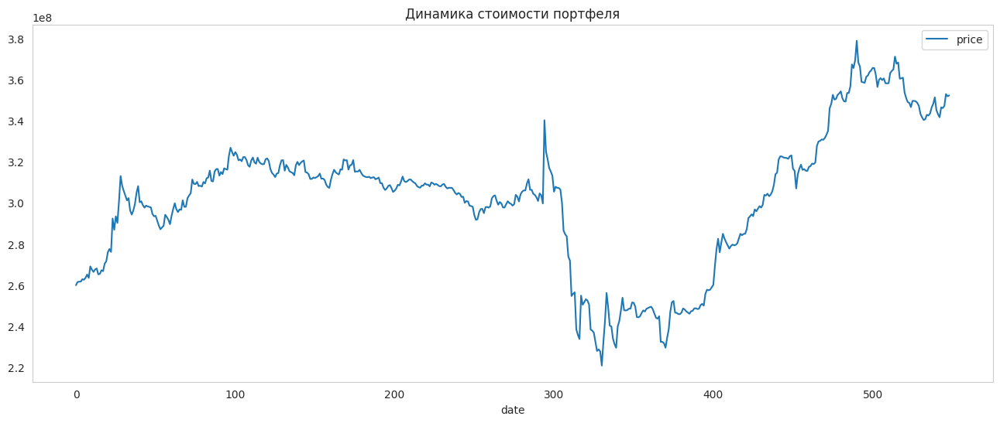

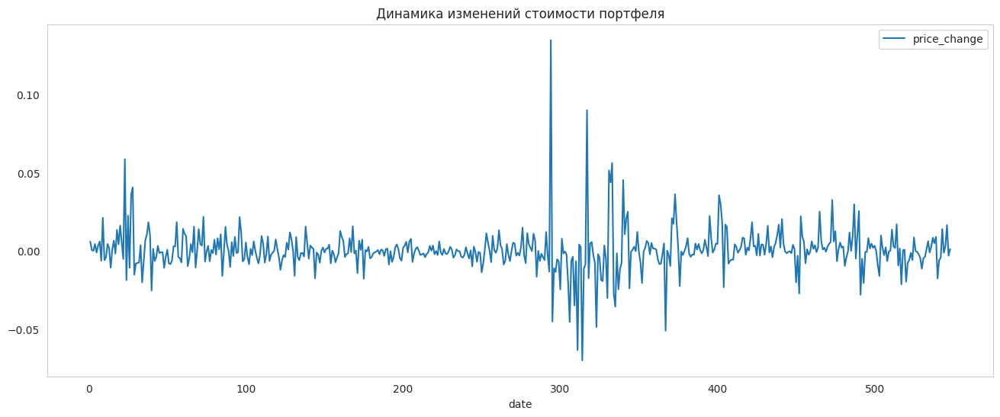

Риск-фактор: VAR 99
Кол-во пробоев: 102
Доля пробоев: 0.2094
Двухсторонняя гипотеза: 0.0
Светофор за тест: red
Односторонняя гипотеза: 0.0
Светофор за тест: red


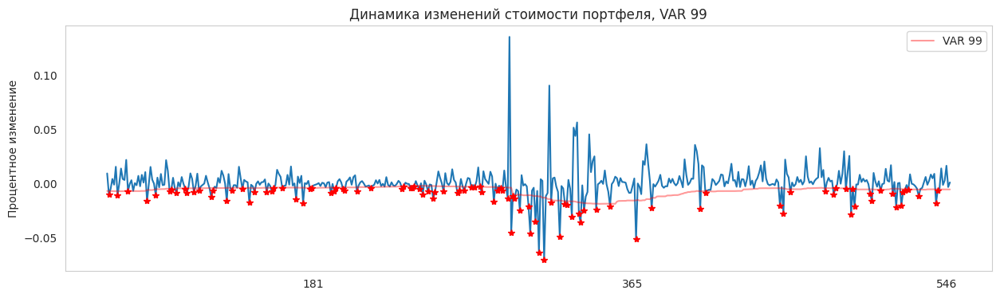

Риск-фактор: ES 97,5
Кол-во пробоев: 101
Доля пробоев: 0.2074
Двухсторонняя гипотеза: 0.0
Светофор за тест: red
Односторонняя гипотеза: 0.0
Светофор за тест: red


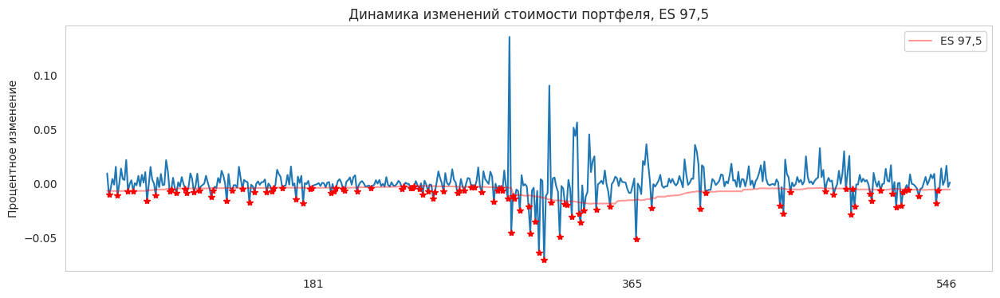

In [107]:
init_tools = {
    "GAZP": 1_000_000,
    "GMKN": 1_000_000,
    "LKOH": 1_000_000,
    "MGNT": 1_000_000,
    "MTSS": 1_000_000,
    "NVTK": 1_000_000,
    "ROSN": 1_000_000,
    "SBER": 1_000_000,
    "TRNFP": 1_000_000,
    "YNDX": 1_000_000,
    "SU26207RMFS9": 10_000_000,
    "SU26212RMFS9": 10_000_000,
    "SU26224RMFS4": 10_000_000,
    "SU26225RMFS1": 10_000_000,
    "SU26228RMFS5": 10_000_000,
    "USD": 100_000_000,
    "EUR": 100_000_000,
}

ps = PortfolioSimulation(init_tools, 60, 1)
ps.plot_dynamics()

ps.calc_test("var_99", "VAR 99", "r*", 0.99)
ps.calc_test("es_97,5", "ES 97,5", "r*", 0.99)

  0%|          | 0/549 [00:00<?, ?it/s]

  0%|          | 0/17 [00:00<?, ?it/s]

  0%|          | 0/487 [00:00<?, ?it/s]

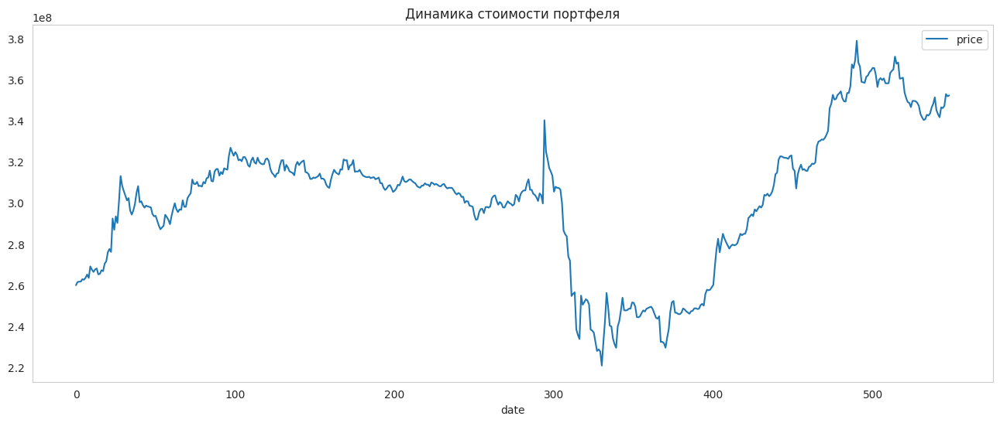

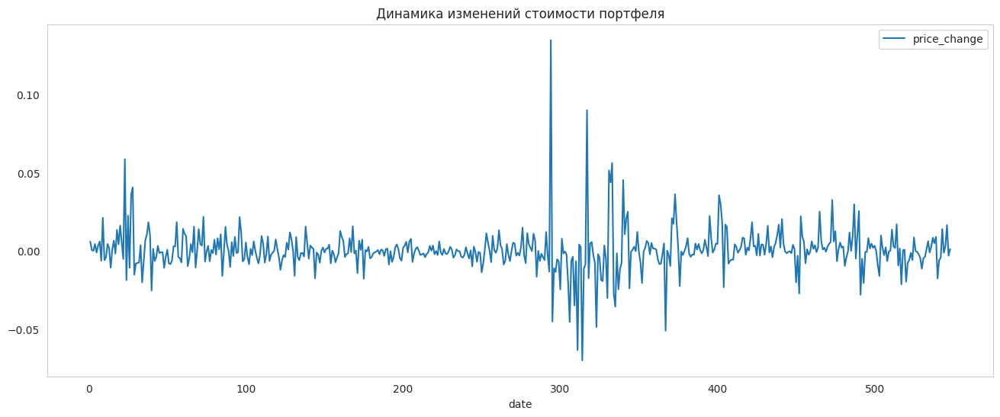

Риск-фактор: VAR 99
Кол-во пробоев: 102
Доля пробоев: 0.2094
Двухсторонняя гипотеза: 0.0
Светофор за тест: red
Односторонняя гипотеза: 0.0
Светофор за тест: red


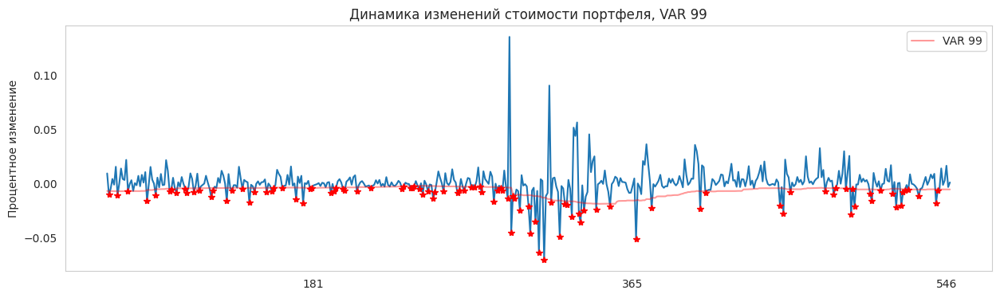

Риск-фактор: ES 97,5
Кол-во пробоев: 101
Доля пробоев: 0.2074
Двухсторонняя гипотеза: 0.0
Светофор за тест: red
Односторонняя гипотеза: 0.0
Светофор за тест: red


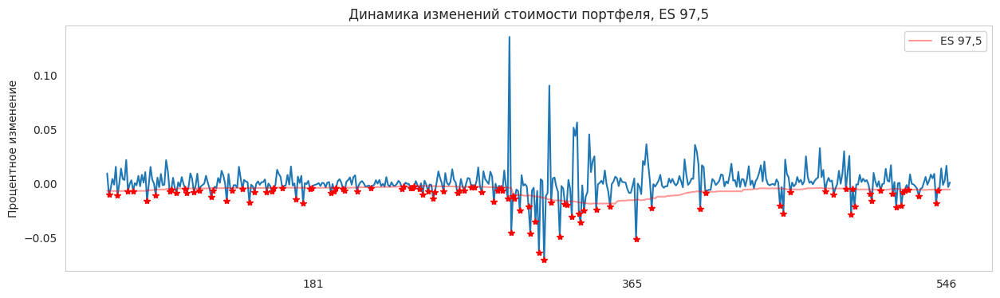

In [108]:
init_tools = {
    "GAZP": 1_000_000,
    "GMKN": 1_000_000,
    "LKOH": 1_000_000,
    "MGNT": 1_000_000,
    "MTSS": 1_000_000,
    "NVTK": 1_000_000,
    "ROSN": 1_000_000,
    "SBER": 1_000_000,
    "TRNFP": 1_000_000,
    "YNDX": 1_000_000,
    "SU26207RMFS9": 10_000_000,
    "SU26212RMFS9": 10_000_000,
    "SU26224RMFS4": 10_000_000,
    "SU26225RMFS1": 10_000_000,
    "SU26228RMFS5": 10_000_000,
    "USD": 100_000_000,
    "EUR": 100_000_000,
}

ps = PortfolioSimulation(init_tools, 60, 1)
ps.plot_dynamics()

ps.calc_test("var_99", "VAR 99", "r*", 0.99)
ps.calc_test("es_97,5", "ES 97,5", "r*", 0.99)

Полный портфель 10 дней

  0%|          | 0/549 [00:00<?, ?it/s]

  0%|          | 0/17 [00:00<?, ?it/s]

  0%|          | 0/478 [00:00<?, ?it/s]

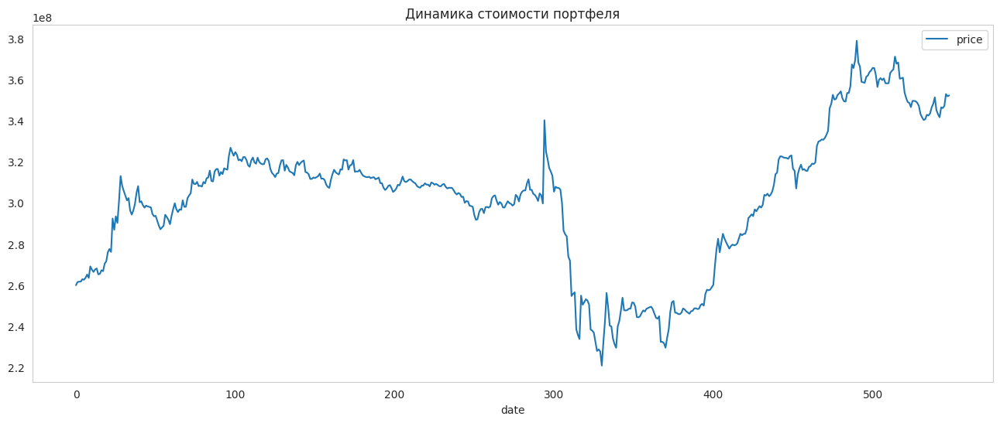

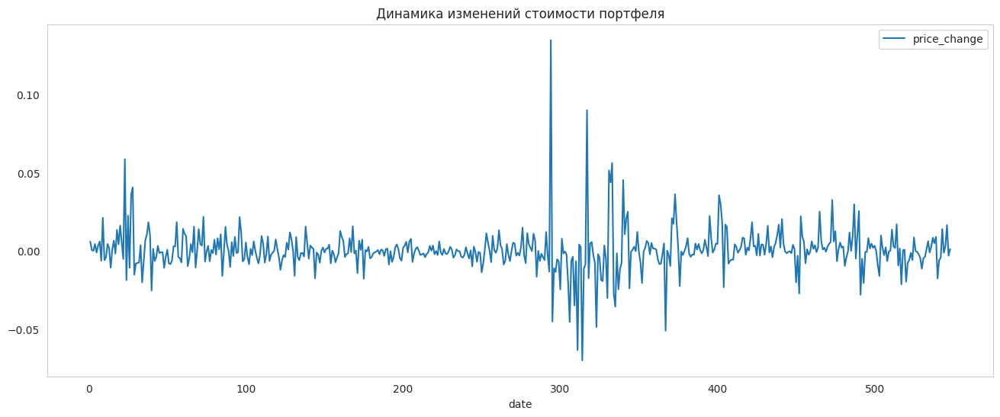

Риск-фактор: VAR 99
Кол-во пробоев: 101
Доля пробоев: 0.2113
Двухсторонняя гипотеза: 0.0
Светофор за тест: red
Односторонняя гипотеза: 0.0
Светофор за тест: red


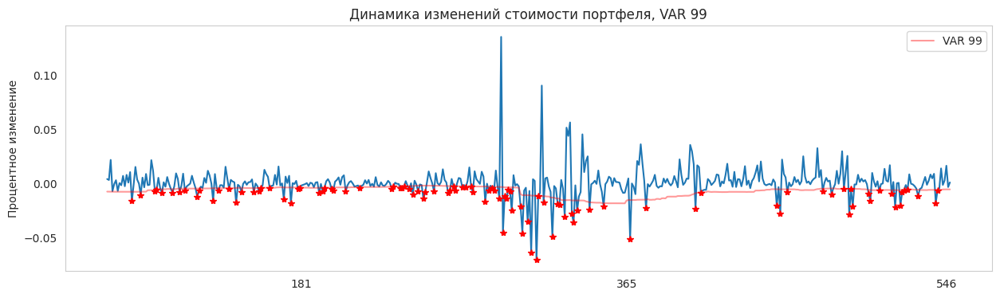

Риск-фактор: ES 97,5
Кол-во пробоев: 97
Доля пробоев: 0.2029
Двухсторонняя гипотеза: 0.0
Светофор за тест: red
Односторонняя гипотеза: 0.0
Светофор за тест: red


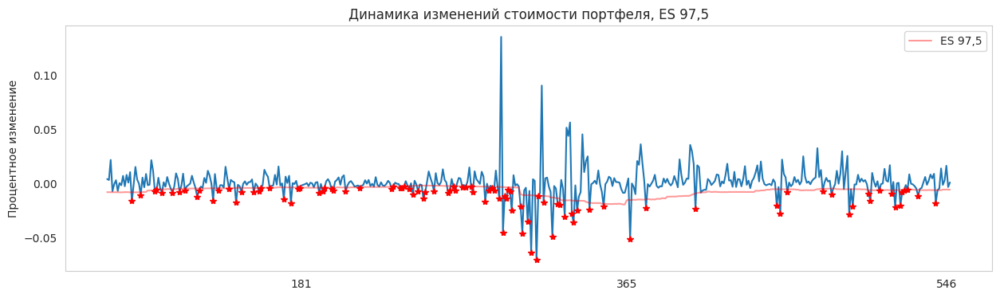

In [109]:
ps = PortfolioSimulation(init_tools, 60, 10)
ps.plot_dynamics()

ps.calc_test("var_99", "VAR 99", "r*", 0.99)
ps.calc_test("es_97,5", "ES 97,5", "r*", 0.99)

Портфель акций 1 день

  0%|          | 0/549 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/487 [00:00<?, ?it/s]

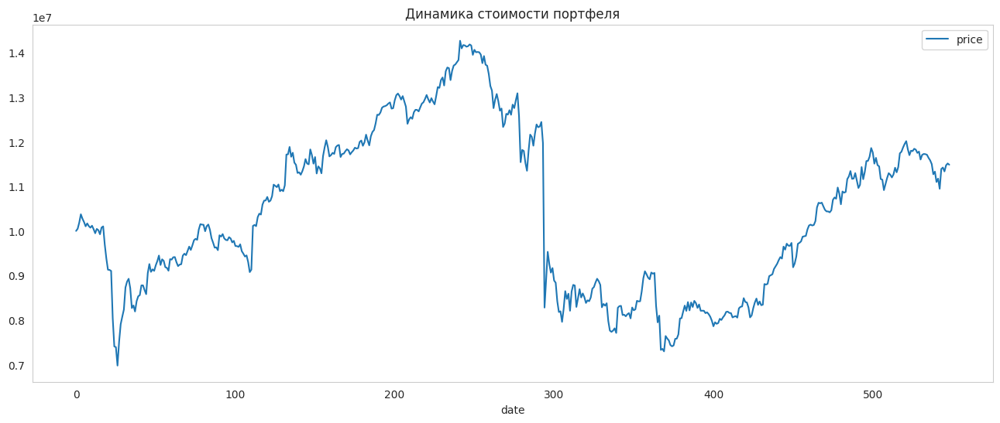

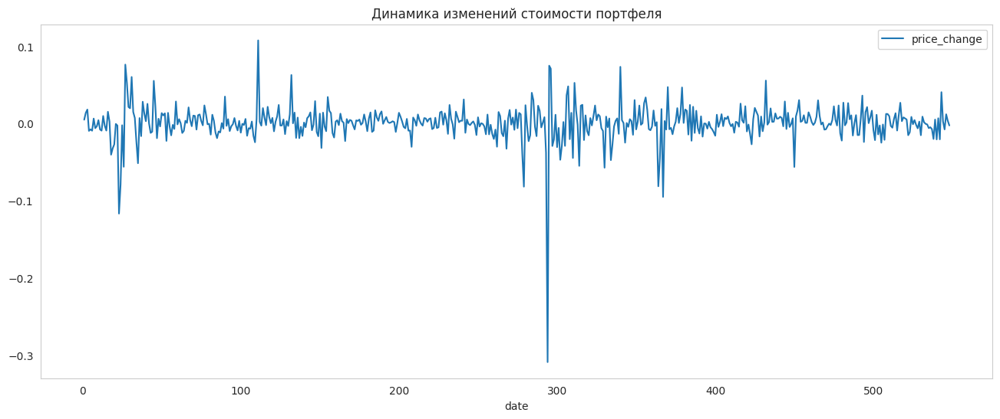

Риск-фактор: VAR 99
Кол-во пробоев: 127
Доля пробоев: 0.2608
Двухсторонняя гипотеза: 0.0
Светофор за тест: red
Односторонняя гипотеза: 0.0
Светофор за тест: red


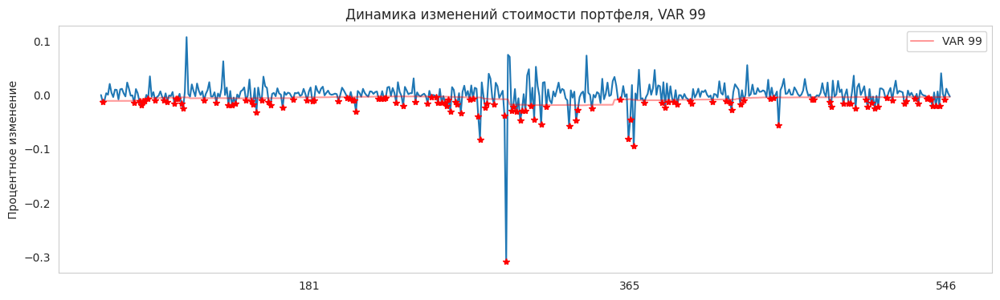

Риск-фактор: ES 97,5
Кол-во пробоев: 127
Доля пробоев: 0.2608
Двухсторонняя гипотеза: 0.0
Светофор за тест: red
Односторонняя гипотеза: 0.0
Светофор за тест: red


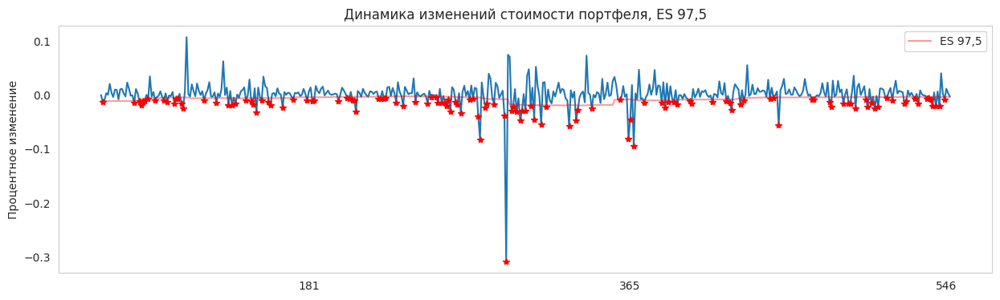

In [110]:
init_tools = {
    "GAZP": 1_000_000,
    "GMKN": 1_000_000,
    "LKOH": 1_000_000,
    "MGNT": 1_000_000,
    "MTSS": 1_000_000,
    "NVTK": 1_000_000,
    "ROSN": 1_000_000,
    "SBER": 1_000_000,
    "TRNFP": 1_000_000,
    "YNDX": 1_000_000
}

ps = PortfolioSimulation(init_tools, 60, 1)
ps.plot_dynamics()

ps.calc_test("var_99", "VAR 99", "r*", 0.99)
ps.calc_test("es_97,5", "ES 97,5", "r*", 0.99)

5.4 Портфель акций 10 дней

  0%|          | 0/549 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/478 [00:00<?, ?it/s]

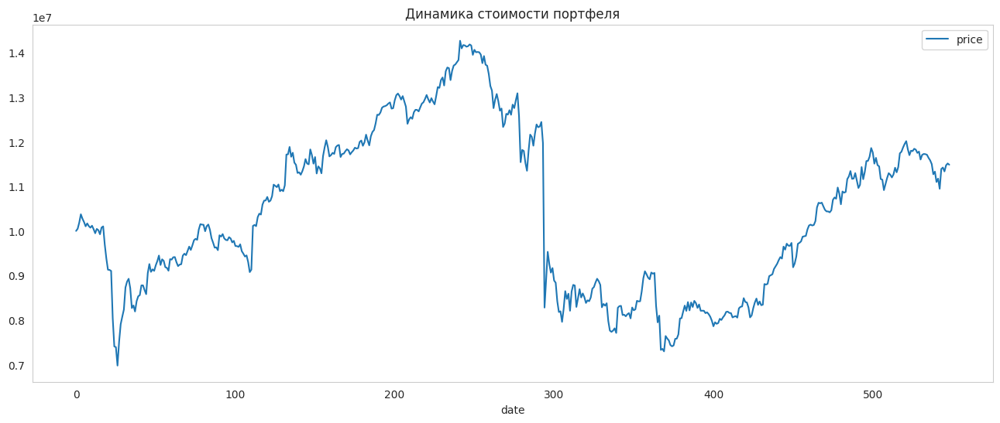

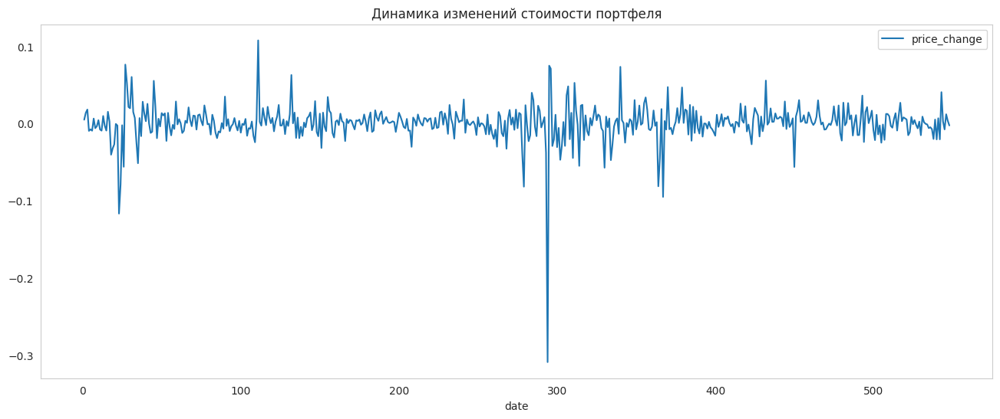

Риск-фактор: VAR 99
Кол-во пробоев: 121
Доля пробоев: 0.2531
Двухсторонняя гипотеза: 0.0
Светофор за тест: red
Односторонняя гипотеза: 0.0
Светофор за тест: red


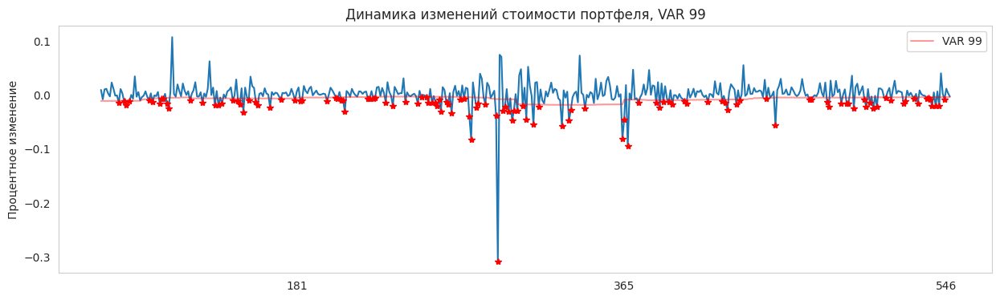

Риск-фактор: ES 97,5
Кол-во пробоев: 121
Доля пробоев: 0.2531
Двухсторонняя гипотеза: 0.0
Светофор за тест: red
Односторонняя гипотеза: 0.0
Светофор за тест: red


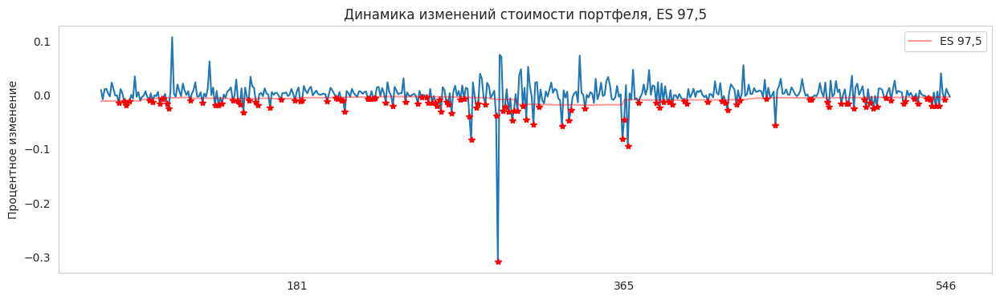

In [111]:
init_tools = {
    "GAZP": 1_000_000,
    "GMKN": 1_000_000,
    "LKOH": 1_000_000,
    "MGNT": 1_000_000,
    "MTSS": 1_000_000,
    "NVTK": 1_000_000,
    "ROSN": 1_000_000,
    "SBER": 1_000_000,
    "TRNFP": 1_000_000,
    "YNDX": 1_000_000
}

ps = PortfolioSimulation(init_tools, 60, 10)
ps.plot_dynamics()

ps.calc_test("var_99", "VAR 99", "r*", 0.99)
ps.calc_test("es_97,5", "ES 97,5", "r*", 0.99)

Портфель облигаций 1 день

  0%|          | 0/549 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/247 [00:00<?, ?it/s]

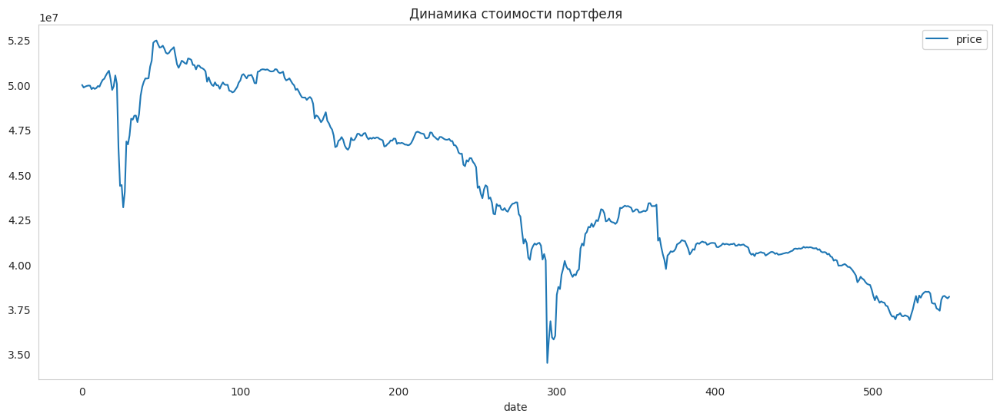

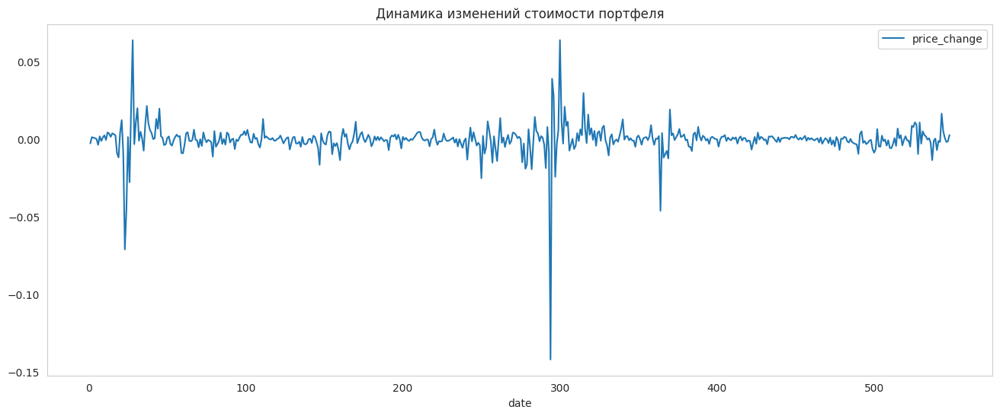

Риск-фактор: VAR 99
Кол-во пробоев: 39
Доля пробоев: 0.1579
Двухсторонняя гипотеза: 0.0
Светофор за тест: red
Односторонняя гипотеза: 0.0
Светофор за тест: red


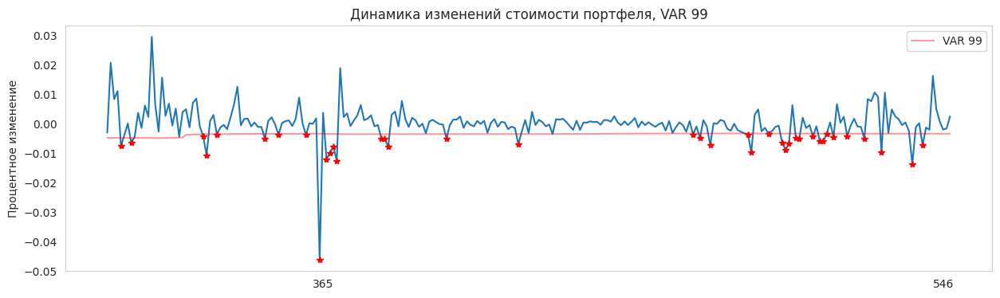

Риск-фактор: ES 97,5
Кол-во пробоев: 36
Доля пробоев: 0.1457
Двухсторонняя гипотеза: 0.0
Светофор за тест: red
Односторонняя гипотеза: 0.0
Светофор за тест: red


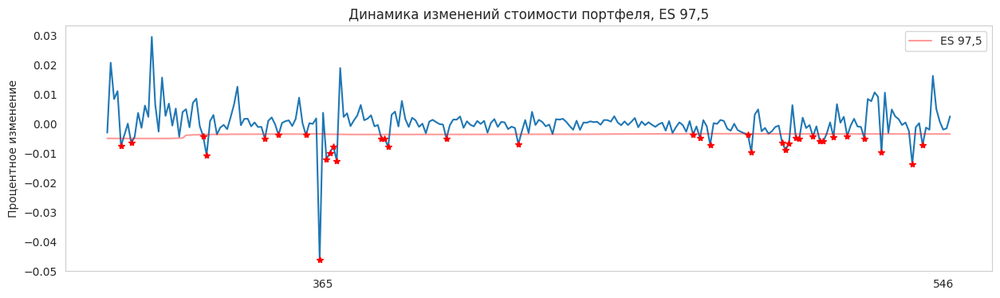

In [112]:
init_tools = {
    "SU26207RMFS9": 10_000_000,
    "SU26212RMFS9": 10_000_000,
    "SU26224RMFS4": 10_000_000,
    "SU26225RMFS1": 10_000_000,
    "SU26228RMFS5": 10_000_000
}

ps = PortfolioSimulation(init_tools, 300, 1)
ps.plot_dynamics()

ps.calc_test("var_99", "VAR 99", "r*", 0.99)
ps.calc_test("es_97,5", "ES 97,5", "r*", 0.99)

Портфель облигаций 10 дней

  0%|          | 0/549 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/238 [00:00<?, ?it/s]

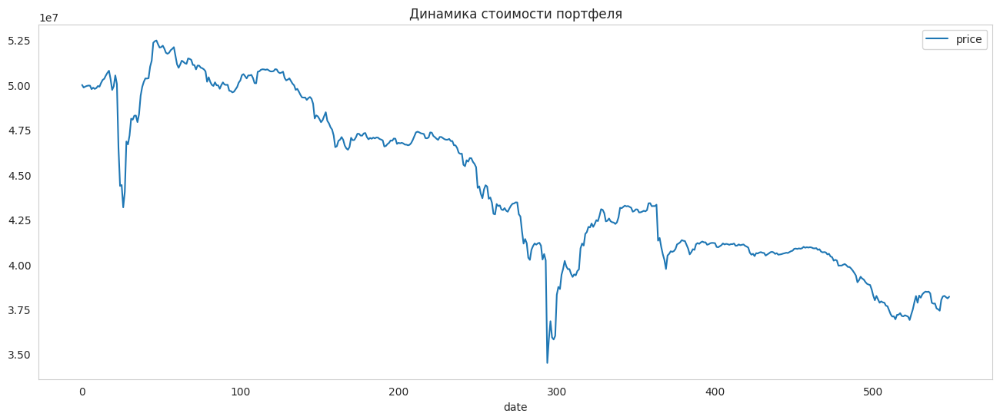

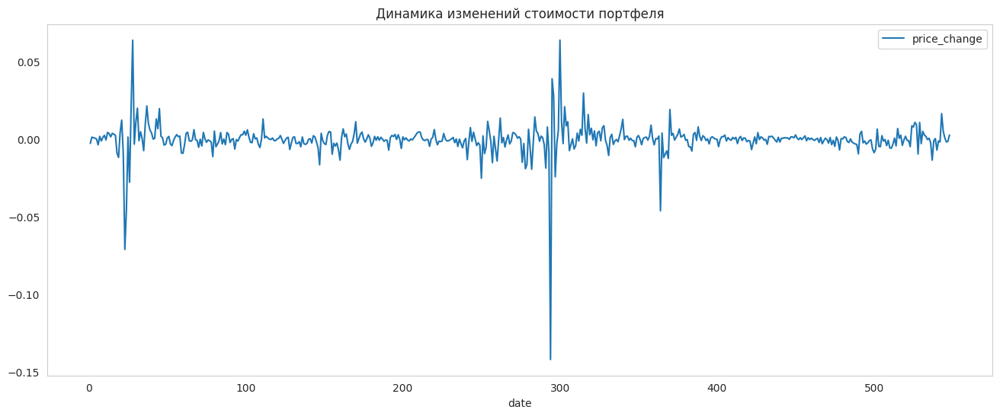

Риск-фактор: VAR 99
Кол-во пробоев: 36
Доля пробоев: 0.1513
Двухсторонняя гипотеза: 0.0
Светофор за тест: red
Односторонняя гипотеза: 0.0
Светофор за тест: red


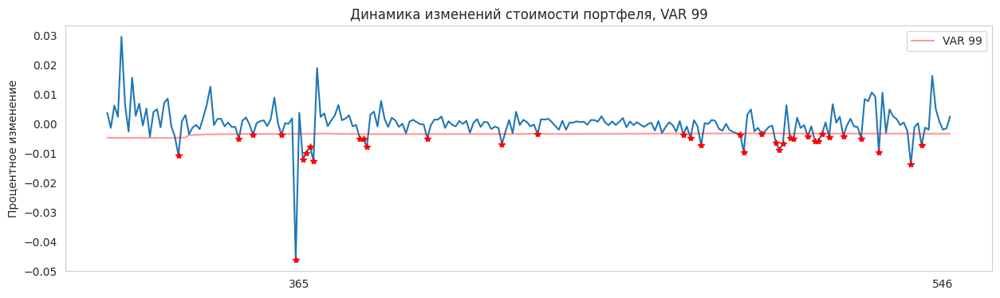

Риск-фактор: ES 97,5
Кол-во пробоев: 35
Доля пробоев: 0.1471
Двухсторонняя гипотеза: 0.0
Светофор за тест: red
Односторонняя гипотеза: 0.0
Светофор за тест: red


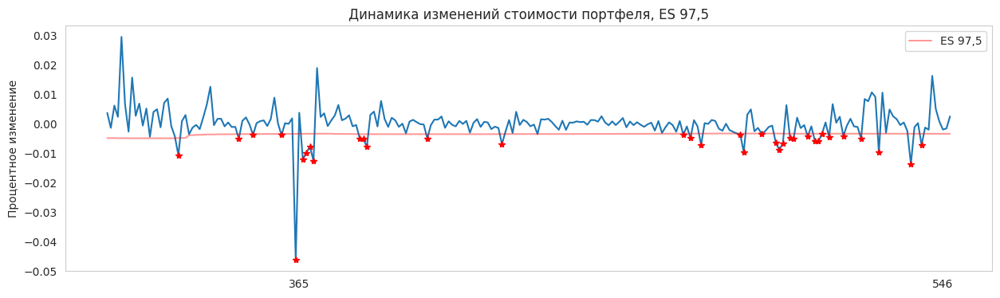

In [113]:
init_tools = {
    "SU26207RMFS9": 10_000_000,
    "SU26212RMFS9": 10_000_000,
    "SU26224RMFS4": 10_000_000,
    "SU26225RMFS1": 10_000_000,
    "SU26228RMFS5": 10_000_000
}
ps = PortfolioSimulation(init_tools, 300, 10)
ps.plot_dynamics()

ps.calc_test("var_99", "VAR 99", "r*", 0.99)
ps.calc_test("es_97,5", "ES 97,5", "r*", 0.99)

Валютный портфель 1 день

  0%|          | 0/549 [00:00<?, ?it/s]

  0%|          | 0/2 [00:00<?, ?it/s]

  0%|          | 0/487 [00:00<?, ?it/s]

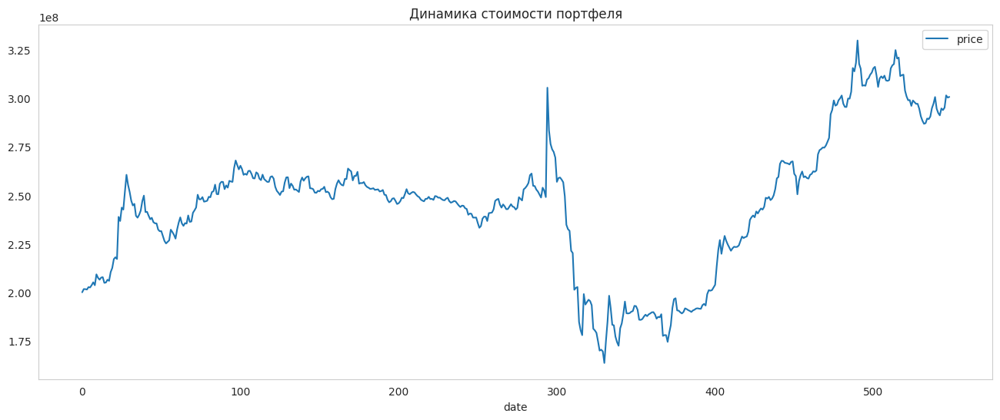

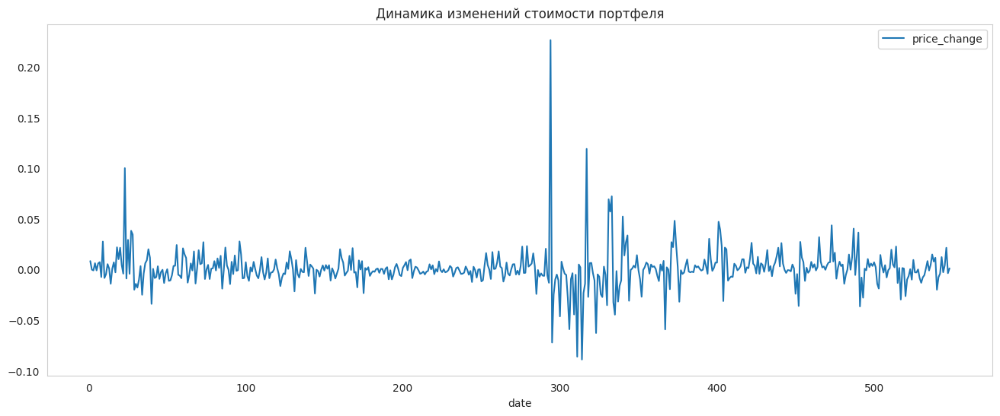

Риск-фактор: VAR 99
Кол-во пробоев: 105
Доля пробоев: 0.2156
Двухсторонняя гипотеза: 0.0
Светофор за тест: red
Односторонняя гипотеза: 0.0
Светофор за тест: red


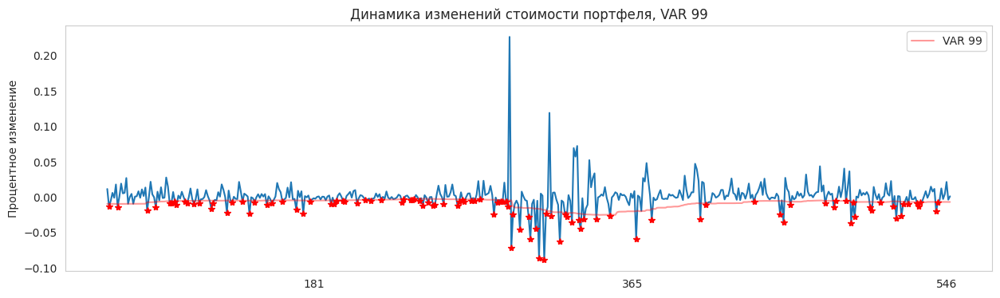

Риск-фактор: ES 97,5
Кол-во пробоев: 105
Доля пробоев: 0.2156
Двухсторонняя гипотеза: 0.0
Светофор за тест: red
Односторонняя гипотеза: 0.0
Светофор за тест: red


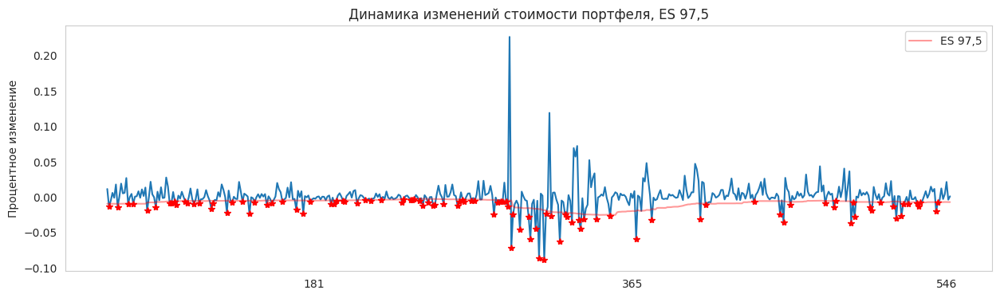

In [114]:
init_tools = {
    "USD": 100_000_000,
    "EUR": 100_000_000
}
ps = PortfolioSimulation(init_tools, 60, 1)
ps.plot_dynamics()

ps.calc_test("var_99", "VAR 99", "r*", 0.99)
ps.calc_test("es_97,5", "ES 97,5", "r*", 0.99)

Валютный портфель 10 дней

  0%|          | 0/549 [00:00<?, ?it/s]

  0%|          | 0/2 [00:00<?, ?it/s]

  0%|          | 0/478 [00:00<?, ?it/s]

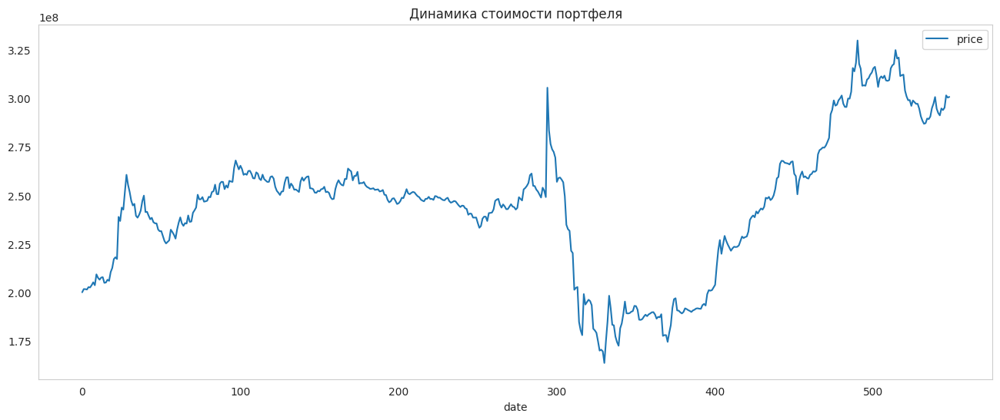

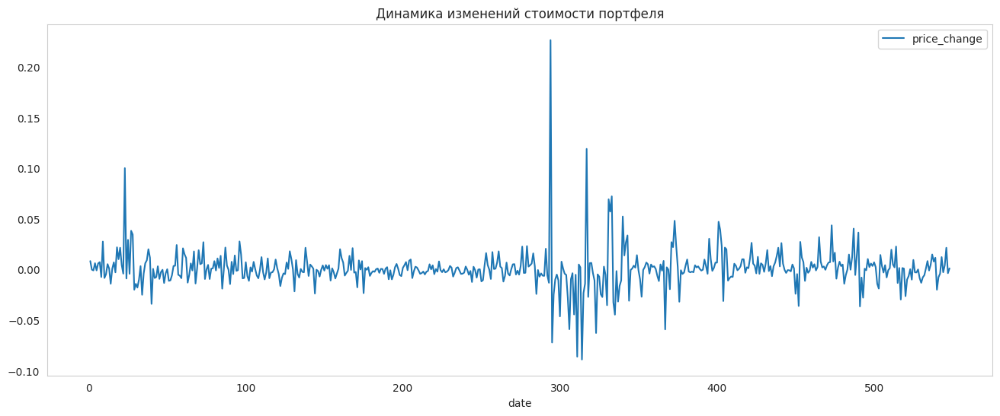

Риск-фактор: VAR 99
Кол-во пробоев: 104
Доля пробоев: 0.2176
Двухсторонняя гипотеза: 0.0
Светофор за тест: red
Односторонняя гипотеза: 0.0
Светофор за тест: red


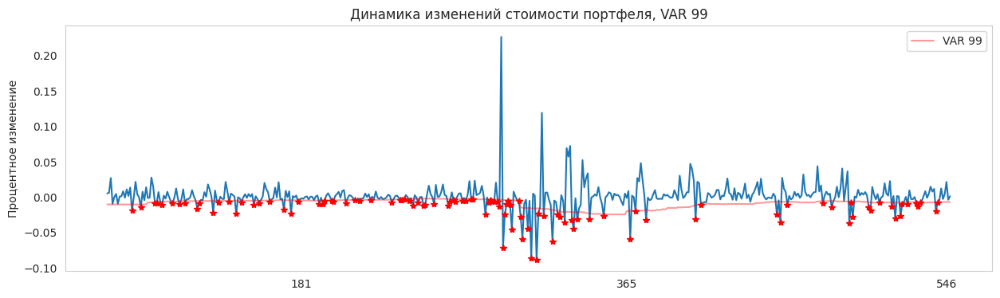

Риск-фактор: ES 97,5
Кол-во пробоев: 103
Доля пробоев: 0.2155
Двухсторонняя гипотеза: 0.0
Светофор за тест: red
Односторонняя гипотеза: 0.0
Светофор за тест: red


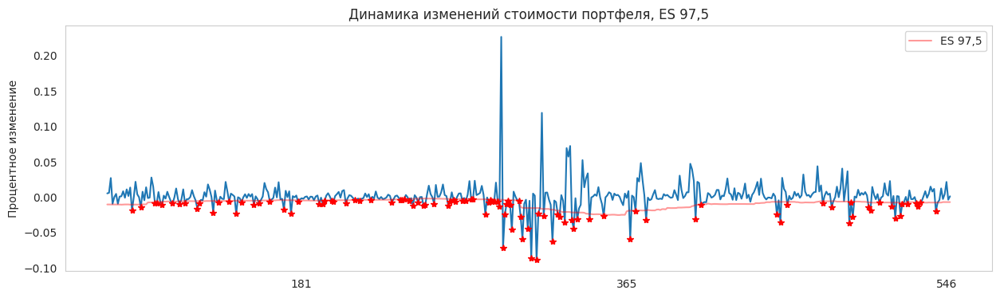

In [115]:
init_tools = {
    "USD": 100_000_000,
    "EUR": 100_000_000
}
ps = PortfolioSimulation(init_tools, 60, 10)
ps.plot_dynamics()

ps.calc_test("var_99", "VAR 99", "r*", 0.99)
ps.calc_test("es_97,5", "ES 97,5", "r*", 0.99)

##Тесты

In [116]:
df_tests = ps.portfolio_prices.merge(ps.portfolio_prices_simulations, left_on='date', right_on='date')

In [117]:
df_tests.dropna(subset=['var_99'], inplace=True)
actual_loss = - df_tests['price_change_x']
predicted_var = - df_tests['var_99']

### Тест Купиека (unconditional test method)

Самым известным безусловным тестированием количества пробоев является тест Kupiec'а. Основополагающая работа [31] была написана в 1995 году, а методика, описанная в журнале, актуальна и на сегодняшний день. Тест Kupiec'a является первым приближением, а предложенные принципы оценки легли в основу более продвинутых методик обратного тестирования.

Тест Kupiec'а, также известный как тест POF (proportion of failures/доля пробоев), проверяет соответствие числа пробоев заданному уровню значимости. Данная методика основана на идее статистического факта, что при условии не отклонения нулевой гипотезы о корректности модели, число пробоев имеет биномиальное распределение. Для того, чтобы это было верно, необходимо сделать предпосылку о независимости реализации пробоя в каждый момент времени. Тогда последовательность единиц и нулей (где 1 - был пробой, 0 - не было) будет являться последовательностью испытаний Бернулли, а общее число пробоев будет иметь биномиальное распределение.

In [118]:
def kupiec_test(actual_losses, predicted_losses, confidence_level):
    n = len(actual_losses)
    failures = sum(actual_losses > predicted_losses)
    alpha = 1 - confidence_level

    test_statistic = -2 * (failures * np.log(alpha) + (n - failures) * np.log(1 - alpha))
    critical_value = 3.841

    if test_statistic > critical_value:
        return False
    else:
        return True

confidence_level = 0.95

result = kupiec_test(actual_loss, predicted_var, confidence_level)
if result:
    print("На уровне значимости 95%: модель корректна")
else:
    print("На уровне значимости 95%: модель некорректна")

На уровне значимости 95%: модель некорректна


### Интервальный тест Christoffersen'а (conditional test method)

Интервальный тест Christoffersen'а является повсеместно используемым тестом количества пробитий с условием на распределение пробитий в течение времени. Данная методика получила свою популярность за счет относительно простого расчета, но при этом недооценка риска существенно минимизирована по сравнению с тестом Kupiec'а, который лег в основу, в том числе, и в интервальный тест Christoffersen'а.

Как и в случае теста Kupiec'а, для целей обратного тестирования по методике Christoffersen'а необходимо определить индикаторную переменную, являющуюся результатом испытания Бернулли.

In [119]:
from scipy.stats import chi2

def christoffersen_test(actual_losses, predicted_losses, confidence_level, horizon):
    T = len(actual_losses)
    h = horizon
    failures = sum(actual_losses[-T+h:] > predicted_losses[-T+h:])
    alpha = 1 - confidence_level

    a = sum(actual_losses[-T+h:])
    b = sum(predicted_losses[-T+h:])
    c = np.sqrt(sum((actual_losses[-T+h:] - a/T)**2))
    d = np.sqrt(sum((predicted_losses[-T+h:] - b/T)**2))

    numerator = (c**2 - d**2 - T * (np.log(c**2) - np.log(d**2)))
    denominator = c**2 * (b/T) * ((b/T) - 1) * (1 - 0.5 * b/T)

    test_statistic = T * numerator / denominator
    critical_value = chi2.ppf(1 - alpha, df=1)

    if test_statistic > critical_value:
        return False  # отвергаем нулевую гипотезу
    else:
        return True   # принимаем нулевую гипотезу

confidence_level = 0.95
horizon = 1

result = christoffersen_test(actual_loss, predicted_var, confidence_level, horizon)
if result:
    print("На уровне значимости 95%: модель корректна")
else:
    print("На уровне значимости 95%: модель некорректна")

На уровне значимости 95%: модель некорректна


### Теста Харлина Топкави (Independence property test method)

Тест Hurlin & Topkavi (2007) является статистическим тестом для проверки адекватности модели Value-at-Risk (VaR). Он используется для оценки точности модели VaR и проверки, насколько хорошо модель предсказывает рыночный риск.

Принцип работы теста Hurlin & Topkavi (2007) заключается в сравнении фактических убытков с предсказанными убытками на основе модели VaR. Критерий теста основан на количестве времени, в течение которого убытки находятся за пределами уровня VaR, что помогает оценить адекватность модели

In [120]:
def hurlin_topkavi_test(actual_losses, predicted_losses, confidence_level):
    n = len(actual_losses)
    failures = sum(actual_losses > predicted_losses)
    alpha = 1 - confidence_level

    PI = 2.995
    c = -np.sqrt(-PI * (1 - PI) / n)
    z = failures / n - PI

    if abs(z) < c:
        return True
    else:
        return False

confidence_level = 0.95

result = hurlin_topkavi_test(actual_loss, predicted_var, confidence_level)
if result:
    print("На уровне значимости 95%: модель корректна")
else:
    print("На уровне значимости 95%: модель некорректна")

На уровне значимости 95%: модель некорректна


### Тест Берковица

Тест Berkowitz et al. (2011) также известен как тест "Backtesting" и используется для оценки адекватности модели оценки риска, такой как Value-at-Risk (VaR), в финансовом моделировании. Основная цель теста Berkowitz - проверить, насколько точно модель VaR предсказывает убытки на финансовом рынке.
Сначала необходимо подготовить фактические убытки и предсказанные убытки на основе модели VaR. Далее происходит вычисление аномалий, т.е. разницы между фактическими убытками и предсказанными убытками.
Далее используется статистическое оценивание аномалий путем применения различных метрик, таких как критерий Купьера-Мартингейла, Conditional Coverage (CC), Marginal Coverage (MC) и другие.

In [121]:
def berkowitz_test(actual_losses, predicted_losses, confidence_level):
    n = len(actual_losses)
    failures = sum(actual_losses > predicted_losses)
    alpha = 1 - confidence_level

    h = 1 / n
    p = failures / n

    d = h - p
    v = p * (1 - p) / n
    z = d / np.sqrt(v)

    critical_value = 1.96

    if abs(z) > critical_value:
        return False
    else:
        return True

confidence_level = 0.95

result = berkowitz_test(actual_loss, predicted_var, confidence_level)
if result:
    print("На уровне значимости 95%: модель корректна")
else:
    print("На уровне значимости 95%: модель некорректна")

На уровне значимости 95%: модель некорректна


### The risk map (Colletaz et al., 2013) (Unconditional test)

This test is very simple to implement and use. It can be applied to any tail risk model
and is a very effective model for the banking industry to use. The framework enables easy
validation of market risk, credit risk or operational risk estimates.

In [122]:
def collettaz_test(real_losses, predicted_losses, alpha=0.05, alpha_prime=0.005):

    VaR_alpha_prime = predicted_losses * 1.1

    # Count violations
    N0 = np.sum(real_losses < predicted_losses)
    N1 = np.sum((real_losses >= predicted_losses) & (real_losses < VaR_alpha_prime))
    N2 = np.sum(real_losses >= VaR_alpha_prime)

    total_observations = len(real_losses)
    LR = -2 * np.log(((1 - alpha) * N0 * (alpha - alpha_prime) * N1 * alpha_prime**N2) / ((N0 / total_observations) * N0 * (N1 / total_observations) * N1 * (N2/total_observations)**N2))

    # Calculate the p-value
    p_value = 1 - chi2.cdf(LR, df=2)

    return p_value < 0.05

result = collettaz_test(actual_loss, predicted_var)
if result:
    print("На уровне значимости 95%: модель корректна")
else:
    print("На уровне значимости 95%: модель некорректна")

На уровне значимости 95%: модель корректна
